# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

A subdirectory or file data already exists.


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [03:17, 921KB/s]                                      
SVHN Testing Set: 64.3MB [00:22, 2.90MB/s]                                     


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [12]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

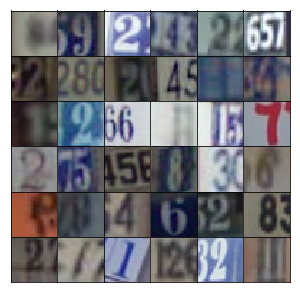

In [13]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [14]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [15]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [16]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [17]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x = tf.layers.dense(z, 4*4*512, activation=None, use_bias=False)
        x = tf.reshape(x, [-1, 4, 4, 512])
        # Batch normalization
        x = tf.layers.batch_normalization(x, training=training)
        # Leaky ReLU
        x = tf.maximum(x, alpha * x)
        
        # First convolutional layer, with shape 8x8x256
        conv_1 = tf.layers.conv2d_transpose(x, 256, 5, strides=2, padding='same', activation=None, use_bias=False)
        # Batch normalization
        conv_1 = tf.layers.batch_normalization(conv_1, training=training)
        # Leaky ReLU
        conv_1 = tf.maximum(conv_1, alpha * conv_1)
        
        # Second convolutional layer, with shape 16x16x128
        conv_2 = tf.layers.conv2d_transpose(conv_1, 128, 5, strides=2, padding='same', activation=None, use_bias=False)
        # Batch normalization
        conv_2 = tf.layers.batch_normalization(conv_2, training=training)
        # Leaky ReLU
        conv_2 = tf.maximum(conv_2, alpha * conv_2)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(conv_2, output_dim, 5, strides=2, padding='same', activation=None, use_bias=False)
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [18]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        # First convolution, 16x16x64
        conv_1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same', activation=None)
        # Leaky ReLU
        conv_1 = tf.maximum(conv_1, alpha * conv_1)
        
        # Second convolution, 8x8x128
        conv_2 = tf.layers.conv2d(conv_1, 128, 5, strides=2, padding='same', activation=None, use_bias=False)
        conv_2 = tf.layers.batch_normalization(conv_2, training=True)
        conv_2 = tf.maximum(conv_2, alpha * conv_2)
        
        # Third convolution, 4x4x256
        conv_3 = tf.layers.conv2d(conv_2, 256, 5, strides=2, padding='same', activation=None, use_bias=False)
        conv_3 = tf.layers.batch_normalization(conv_3, training=True)
        conv_3 = tf.maximum(conv_3, alpha * conv_3)
        
        flat = tf.reshape(conv_3, [-1, 4*4*256])
        logits = tf.layers.dense(flat, 1, activation=None)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [19]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [20]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [26]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [27]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [28]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [35]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.1436... Generator Loss: 0.9603
Epoch 1/25... Discriminator Loss: 0.3502... Generator Loss: 4.0582
Epoch 1/25... Discriminator Loss: 0.1215... Generator Loss: 5.5627
Epoch 1/25... Discriminator Loss: 0.1658... Generator Loss: 2.7863
Epoch 1/25... Discriminator Loss: 0.1531... Generator Loss: 2.8633
Epoch 1/25... Discriminator Loss: 0.1857... Generator Loss: 2.4363
Epoch 1/25... Discriminator Loss: 0.1163... Generator Loss: 2.9355
Epoch 1/25... Discriminator Loss: 0.1520... Generator Loss: 2.6573
Epoch 1/25... Discriminator Loss: 0.1462... Generator Loss: 3.1949
Epoch 1/25... Discriminator Loss: 0.5241... Generator Loss: 1.9372


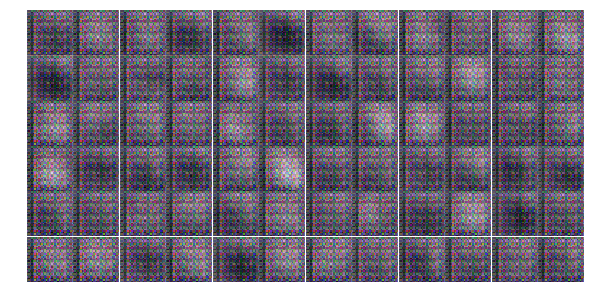

Epoch 1/25... Discriminator Loss: 0.5403... Generator Loss: 1.6576
Epoch 1/25... Discriminator Loss: 0.6324... Generator Loss: 1.4934
Epoch 1/25... Discriminator Loss: 0.5827... Generator Loss: 1.1911
Epoch 1/25... Discriminator Loss: 0.3221... Generator Loss: 1.8931
Epoch 1/25... Discriminator Loss: 0.4199... Generator Loss: 1.8158
Epoch 1/25... Discriminator Loss: 0.4184... Generator Loss: 1.8351
Epoch 1/25... Discriminator Loss: 0.5370... Generator Loss: 1.9220
Epoch 1/25... Discriminator Loss: 0.3112... Generator Loss: 2.8672
Epoch 1/25... Discriminator Loss: 1.4999... Generator Loss: 0.3368
Epoch 1/25... Discriminator Loss: 0.4037... Generator Loss: 2.6335


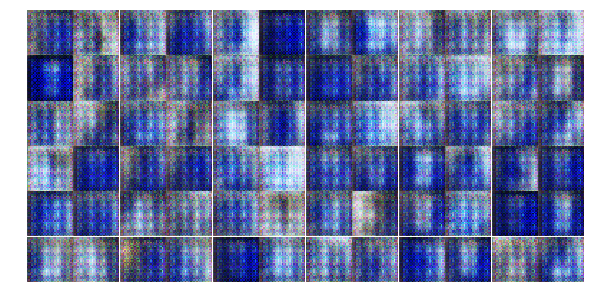

Epoch 1/25... Discriminator Loss: 0.1934... Generator Loss: 2.4985
Epoch 1/25... Discriminator Loss: 0.2386... Generator Loss: 2.4921
Epoch 1/25... Discriminator Loss: 0.4651... Generator Loss: 2.1063
Epoch 1/25... Discriminator Loss: 0.8704... Generator Loss: 0.9277
Epoch 1/25... Discriminator Loss: 0.3182... Generator Loss: 1.8795
Epoch 1/25... Discriminator Loss: 0.6832... Generator Loss: 1.0539
Epoch 1/25... Discriminator Loss: 1.3904... Generator Loss: 1.9023
Epoch 1/25... Discriminator Loss: 0.8582... Generator Loss: 0.9023
Epoch 1/25... Discriminator Loss: 1.7251... Generator Loss: 0.4083
Epoch 1/25... Discriminator Loss: 0.5347... Generator Loss: 2.1585


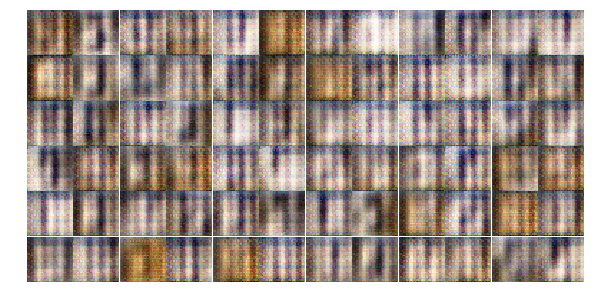

Epoch 1/25... Discriminator Loss: 1.0695... Generator Loss: 0.9134
Epoch 1/25... Discriminator Loss: 0.7109... Generator Loss: 1.5287
Epoch 1/25... Discriminator Loss: 0.6415... Generator Loss: 1.3853
Epoch 1/25... Discriminator Loss: 0.7302... Generator Loss: 1.3960
Epoch 1/25... Discriminator Loss: 0.9787... Generator Loss: 0.8825
Epoch 1/25... Discriminator Loss: 0.5865... Generator Loss: 1.5048
Epoch 1/25... Discriminator Loss: 0.4345... Generator Loss: 1.6395
Epoch 1/25... Discriminator Loss: 0.4549... Generator Loss: 2.1216
Epoch 1/25... Discriminator Loss: 0.4420... Generator Loss: 1.8156
Epoch 1/25... Discriminator Loss: 0.4414... Generator Loss: 1.8209


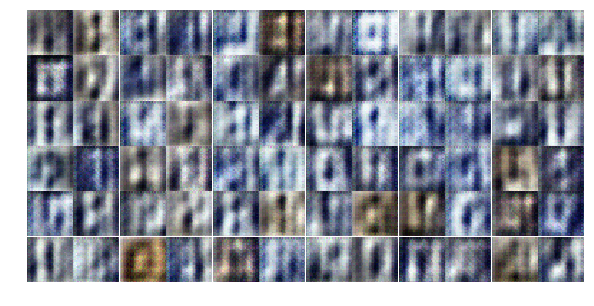

Epoch 1/25... Discriminator Loss: 0.6013... Generator Loss: 2.3104
Epoch 1/25... Discriminator Loss: 0.9200... Generator Loss: 1.1086
Epoch 1/25... Discriminator Loss: 0.6606... Generator Loss: 1.2677
Epoch 1/25... Discriminator Loss: 0.8255... Generator Loss: 1.0242
Epoch 1/25... Discriminator Loss: 0.6867... Generator Loss: 2.0129
Epoch 1/25... Discriminator Loss: 0.9176... Generator Loss: 2.0227
Epoch 1/25... Discriminator Loss: 0.8016... Generator Loss: 1.5827
Epoch 1/25... Discriminator Loss: 1.0631... Generator Loss: 1.0318
Epoch 1/25... Discriminator Loss: 0.7452... Generator Loss: 1.1896
Epoch 1/25... Discriminator Loss: 0.9628... Generator Loss: 1.2909


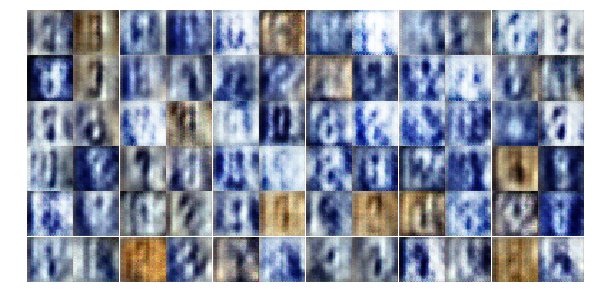

Epoch 1/25... Discriminator Loss: 0.7776... Generator Loss: 0.9399
Epoch 1/25... Discriminator Loss: 1.0156... Generator Loss: 1.2355
Epoch 1/25... Discriminator Loss: 0.7230... Generator Loss: 1.4312
Epoch 1/25... Discriminator Loss: 0.8330... Generator Loss: 1.1208
Epoch 1/25... Discriminator Loss: 0.9293... Generator Loss: 1.5794
Epoch 1/25... Discriminator Loss: 0.7307... Generator Loss: 1.3477
Epoch 1/25... Discriminator Loss: 1.1184... Generator Loss: 0.9243
Epoch 2/25... Discriminator Loss: 1.0740... Generator Loss: 1.2751
Epoch 2/25... Discriminator Loss: 0.8942... Generator Loss: 1.7651
Epoch 2/25... Discriminator Loss: 1.2542... Generator Loss: 0.6790


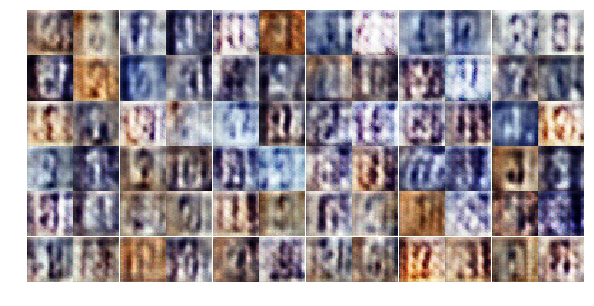

Epoch 2/25... Discriminator Loss: 1.0498... Generator Loss: 0.8870
Epoch 2/25... Discriminator Loss: 1.1756... Generator Loss: 0.7858
Epoch 2/25... Discriminator Loss: 1.4467... Generator Loss: 0.7077
Epoch 2/25... Discriminator Loss: 1.1402... Generator Loss: 0.9859
Epoch 2/25... Discriminator Loss: 1.1862... Generator Loss: 0.8455
Epoch 2/25... Discriminator Loss: 1.2642... Generator Loss: 1.2866
Epoch 2/25... Discriminator Loss: 1.2794... Generator Loss: 0.8210
Epoch 2/25... Discriminator Loss: 1.0477... Generator Loss: 1.2028
Epoch 2/25... Discriminator Loss: 0.9998... Generator Loss: 1.0579
Epoch 2/25... Discriminator Loss: 1.0744... Generator Loss: 0.7952


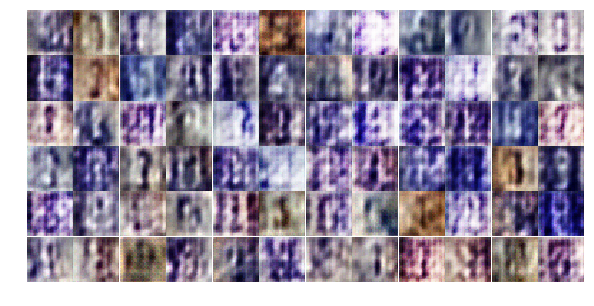

Epoch 2/25... Discriminator Loss: 1.3179... Generator Loss: 0.7016
Epoch 2/25... Discriminator Loss: 0.9638... Generator Loss: 1.1031
Epoch 2/25... Discriminator Loss: 0.8313... Generator Loss: 1.5781
Epoch 2/25... Discriminator Loss: 0.8127... Generator Loss: 1.2994
Epoch 2/25... Discriminator Loss: 1.0303... Generator Loss: 1.0789
Epoch 2/25... Discriminator Loss: 1.1125... Generator Loss: 0.8361
Epoch 2/25... Discriminator Loss: 1.2099... Generator Loss: 0.8571
Epoch 2/25... Discriminator Loss: 0.9026... Generator Loss: 0.9907
Epoch 2/25... Discriminator Loss: 1.1524... Generator Loss: 1.1361
Epoch 2/25... Discriminator Loss: 1.2503... Generator Loss: 0.6093


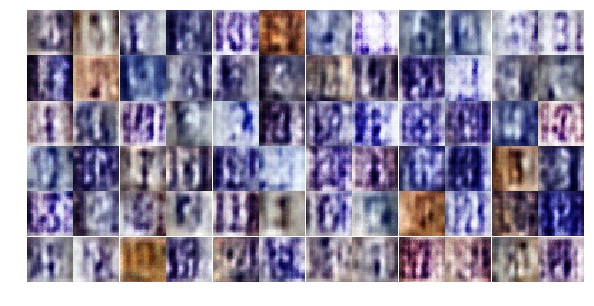

Epoch 2/25... Discriminator Loss: 1.2711... Generator Loss: 0.7424
Epoch 2/25... Discriminator Loss: 1.0798... Generator Loss: 1.3532
Epoch 2/25... Discriminator Loss: 0.7693... Generator Loss: 1.2263
Epoch 2/25... Discriminator Loss: 1.0703... Generator Loss: 1.5776
Epoch 2/25... Discriminator Loss: 0.8967... Generator Loss: 1.1502
Epoch 2/25... Discriminator Loss: 0.8474... Generator Loss: 0.9679
Epoch 2/25... Discriminator Loss: 0.9862... Generator Loss: 1.1791
Epoch 2/25... Discriminator Loss: 1.1017... Generator Loss: 0.8209
Epoch 2/25... Discriminator Loss: 1.1006... Generator Loss: 0.7209
Epoch 2/25... Discriminator Loss: 0.9319... Generator Loss: 1.0557


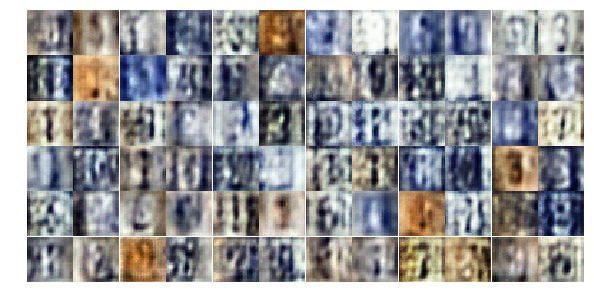

Epoch 2/25... Discriminator Loss: 1.0015... Generator Loss: 0.9843
Epoch 2/25... Discriminator Loss: 1.0688... Generator Loss: 1.0347
Epoch 2/25... Discriminator Loss: 1.3211... Generator Loss: 0.5833
Epoch 2/25... Discriminator Loss: 0.9758... Generator Loss: 1.2033
Epoch 2/25... Discriminator Loss: 0.9844... Generator Loss: 1.1615
Epoch 2/25... Discriminator Loss: 0.8508... Generator Loss: 0.9623
Epoch 2/25... Discriminator Loss: 1.0099... Generator Loss: 0.8930
Epoch 2/25... Discriminator Loss: 0.9560... Generator Loss: 1.5092
Epoch 2/25... Discriminator Loss: 1.2023... Generator Loss: 0.8717
Epoch 2/25... Discriminator Loss: 1.0431... Generator Loss: 1.1814


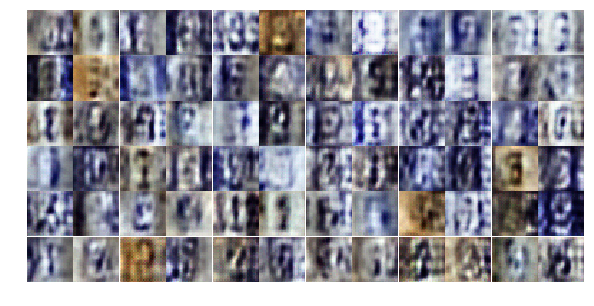

Epoch 2/25... Discriminator Loss: 0.7105... Generator Loss: 1.8232
Epoch 2/25... Discriminator Loss: 1.3803... Generator Loss: 0.8265
Epoch 2/25... Discriminator Loss: 0.7165... Generator Loss: 1.5100
Epoch 2/25... Discriminator Loss: 1.1970... Generator Loss: 0.5694
Epoch 2/25... Discriminator Loss: 1.0331... Generator Loss: 0.9235
Epoch 2/25... Discriminator Loss: 0.9219... Generator Loss: 1.1408
Epoch 2/25... Discriminator Loss: 1.0305... Generator Loss: 1.8638
Epoch 2/25... Discriminator Loss: 1.0375... Generator Loss: 0.8044
Epoch 2/25... Discriminator Loss: 0.5925... Generator Loss: 1.6731
Epoch 2/25... Discriminator Loss: 0.7427... Generator Loss: 1.9340


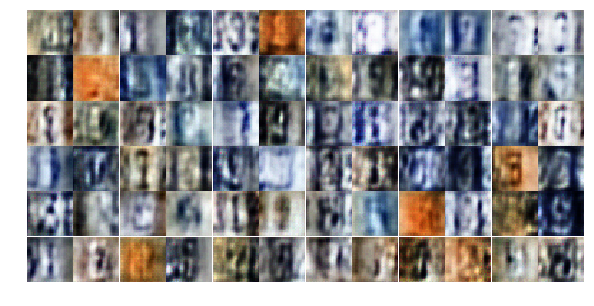

Epoch 2/25... Discriminator Loss: 0.7916... Generator Loss: 1.1060
Epoch 2/25... Discriminator Loss: 0.6420... Generator Loss: 1.3642
Epoch 2/25... Discriminator Loss: 1.1533... Generator Loss: 0.6157
Epoch 2/25... Discriminator Loss: 0.5773... Generator Loss: 1.7005
Epoch 3/25... Discriminator Loss: 0.4625... Generator Loss: 1.6388
Epoch 3/25... Discriminator Loss: 0.4465... Generator Loss: 1.7507
Epoch 3/25... Discriminator Loss: 1.5163... Generator Loss: 3.0641
Epoch 3/25... Discriminator Loss: 0.6322... Generator Loss: 1.1749
Epoch 3/25... Discriminator Loss: 0.5935... Generator Loss: 1.3962
Epoch 3/25... Discriminator Loss: 0.7444... Generator Loss: 1.0469


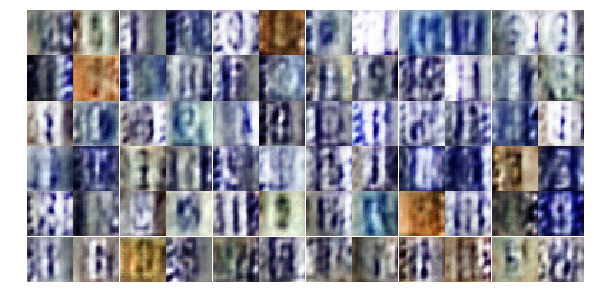

Epoch 3/25... Discriminator Loss: 0.3397... Generator Loss: 1.8307
Epoch 3/25... Discriminator Loss: 0.6763... Generator Loss: 1.4413
Epoch 3/25... Discriminator Loss: 1.0043... Generator Loss: 0.6158
Epoch 3/25... Discriminator Loss: 1.3370... Generator Loss: 0.4527
Epoch 3/25... Discriminator Loss: 0.8185... Generator Loss: 0.8666
Epoch 3/25... Discriminator Loss: 1.2769... Generator Loss: 0.4751
Epoch 3/25... Discriminator Loss: 0.6350... Generator Loss: 1.6476
Epoch 3/25... Discriminator Loss: 0.5857... Generator Loss: 2.0148
Epoch 3/25... Discriminator Loss: 0.4706... Generator Loss: 1.4701
Epoch 3/25... Discriminator Loss: 0.8735... Generator Loss: 0.9966


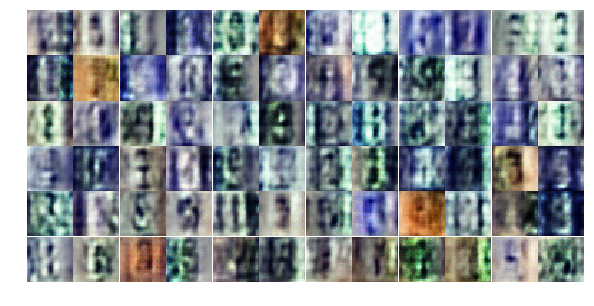

Epoch 3/25... Discriminator Loss: 0.5098... Generator Loss: 1.5805
Epoch 3/25... Discriminator Loss: 0.3484... Generator Loss: 1.8790
Epoch 3/25... Discriminator Loss: 1.0625... Generator Loss: 0.7215
Epoch 3/25... Discriminator Loss: 0.5181... Generator Loss: 1.7269
Epoch 3/25... Discriminator Loss: 0.2208... Generator Loss: 2.8541
Epoch 3/25... Discriminator Loss: 0.7998... Generator Loss: 1.2744
Epoch 3/25... Discriminator Loss: 0.4383... Generator Loss: 1.4057
Epoch 3/25... Discriminator Loss: 1.0759... Generator Loss: 3.0121
Epoch 3/25... Discriminator Loss: 0.6685... Generator Loss: 2.9719
Epoch 3/25... Discriminator Loss: 0.6057... Generator Loss: 1.2794


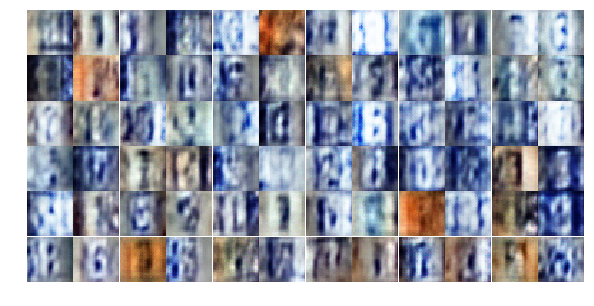

Epoch 3/25... Discriminator Loss: 0.5374... Generator Loss: 1.7048
Epoch 3/25... Discriminator Loss: 0.5543... Generator Loss: 1.2818
Epoch 3/25... Discriminator Loss: 0.4431... Generator Loss: 1.5337
Epoch 3/25... Discriminator Loss: 0.9348... Generator Loss: 0.6086
Epoch 3/25... Discriminator Loss: 1.1801... Generator Loss: 0.4751
Epoch 3/25... Discriminator Loss: 1.0226... Generator Loss: 0.6608
Epoch 3/25... Discriminator Loss: 1.0393... Generator Loss: 0.6585
Epoch 3/25... Discriminator Loss: 0.3945... Generator Loss: 3.8638
Epoch 3/25... Discriminator Loss: 1.4503... Generator Loss: 0.4622
Epoch 3/25... Discriminator Loss: 0.5075... Generator Loss: 1.4940


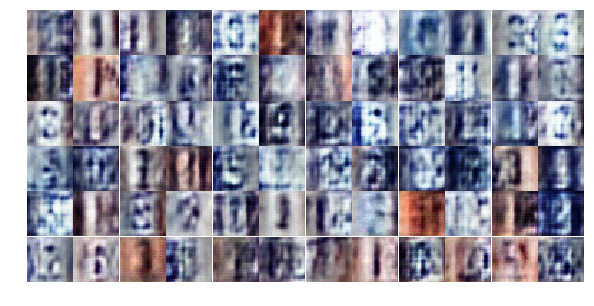

Epoch 3/25... Discriminator Loss: 0.3568... Generator Loss: 1.9380
Epoch 3/25... Discriminator Loss: 0.2828... Generator Loss: 2.8925
Epoch 3/25... Discriminator Loss: 0.8231... Generator Loss: 1.0548
Epoch 3/25... Discriminator Loss: 0.3622... Generator Loss: 2.0268
Epoch 3/25... Discriminator Loss: 0.1383... Generator Loss: 2.8177
Epoch 3/25... Discriminator Loss: 2.5801... Generator Loss: 5.0225
Epoch 3/25... Discriminator Loss: 0.3877... Generator Loss: 2.4399
Epoch 3/25... Discriminator Loss: 0.4648... Generator Loss: 2.0205
Epoch 3/25... Discriminator Loss: 0.8138... Generator Loss: 2.1360
Epoch 3/25... Discriminator Loss: 0.8094... Generator Loss: 1.2306


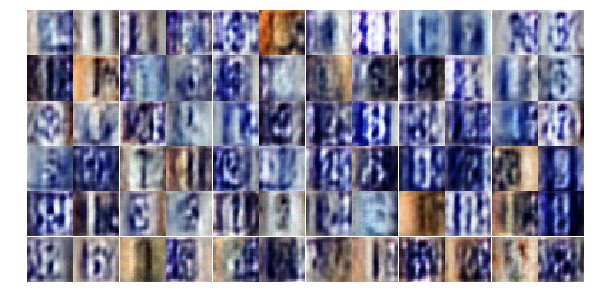

Epoch 3/25... Discriminator Loss: 0.5061... Generator Loss: 1.8025
Epoch 3/25... Discriminator Loss: 0.6949... Generator Loss: 1.0069
Epoch 3/25... Discriminator Loss: 0.6588... Generator Loss: 1.2479
Epoch 3/25... Discriminator Loss: 0.3359... Generator Loss: 1.9341
Epoch 3/25... Discriminator Loss: 0.4577... Generator Loss: 2.9339
Epoch 3/25... Discriminator Loss: 0.8078... Generator Loss: 1.2761
Epoch 3/25... Discriminator Loss: 0.9107... Generator Loss: 0.7459
Epoch 3/25... Discriminator Loss: 0.5488... Generator Loss: 2.0310
Epoch 3/25... Discriminator Loss: 0.5685... Generator Loss: 1.3629
Epoch 3/25... Discriminator Loss: 0.4339... Generator Loss: 3.5172


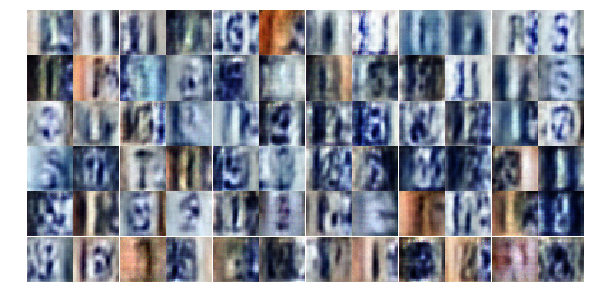

Epoch 3/25... Discriminator Loss: 0.7199... Generator Loss: 1.4465
Epoch 4/25... Discriminator Loss: 0.5924... Generator Loss: 1.6199
Epoch 4/25... Discriminator Loss: 0.5946... Generator Loss: 1.4421
Epoch 4/25... Discriminator Loss: 1.3168... Generator Loss: 0.4405
Epoch 4/25... Discriminator Loss: 0.3856... Generator Loss: 1.9784
Epoch 4/25... Discriminator Loss: 0.6971... Generator Loss: 0.9324
Epoch 4/25... Discriminator Loss: 1.4834... Generator Loss: 3.5333
Epoch 4/25... Discriminator Loss: 0.6847... Generator Loss: 1.0708
Epoch 4/25... Discriminator Loss: 0.2936... Generator Loss: 2.3602
Epoch 4/25... Discriminator Loss: 0.5622... Generator Loss: 1.3441


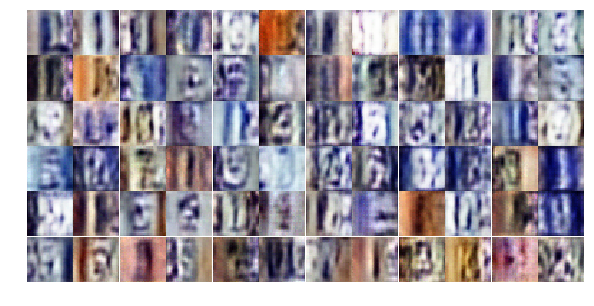

Epoch 4/25... Discriminator Loss: 0.6427... Generator Loss: 2.9051
Epoch 4/25... Discriminator Loss: 0.8632... Generator Loss: 0.7758
Epoch 4/25... Discriminator Loss: 0.6901... Generator Loss: 1.0986
Epoch 4/25... Discriminator Loss: 0.6312... Generator Loss: 2.2677
Epoch 4/25... Discriminator Loss: 1.4122... Generator Loss: 0.3735
Epoch 4/25... Discriminator Loss: 1.6077... Generator Loss: 0.3173
Epoch 4/25... Discriminator Loss: 0.8193... Generator Loss: 1.1627
Epoch 4/25... Discriminator Loss: 0.4461... Generator Loss: 2.4681
Epoch 4/25... Discriminator Loss: 0.4228... Generator Loss: 1.8843
Epoch 4/25... Discriminator Loss: 0.7862... Generator Loss: 2.4716


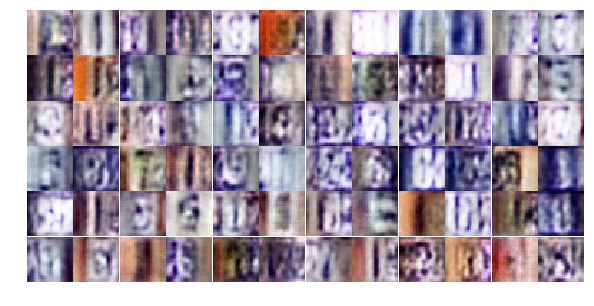

Epoch 4/25... Discriminator Loss: 0.7151... Generator Loss: 1.0678
Epoch 4/25... Discriminator Loss: 0.5678... Generator Loss: 1.6663
Epoch 4/25... Discriminator Loss: 0.8136... Generator Loss: 2.8014
Epoch 4/25... Discriminator Loss: 0.3838... Generator Loss: 1.9433
Epoch 4/25... Discriminator Loss: 0.4783... Generator Loss: 1.7107
Epoch 4/25... Discriminator Loss: 0.3739... Generator Loss: 1.9243
Epoch 4/25... Discriminator Loss: 0.4402... Generator Loss: 1.5286
Epoch 4/25... Discriminator Loss: 0.9852... Generator Loss: 0.6909
Epoch 4/25... Discriminator Loss: 0.3899... Generator Loss: 1.7424
Epoch 4/25... Discriminator Loss: 0.5905... Generator Loss: 1.0788


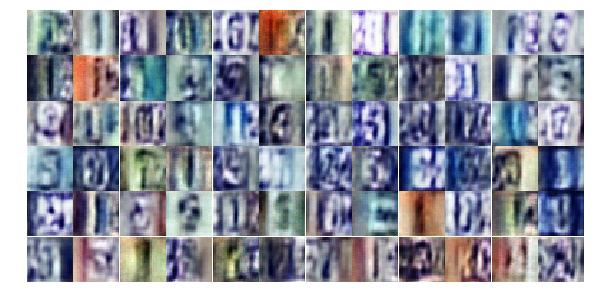

Epoch 4/25... Discriminator Loss: 0.2971... Generator Loss: 2.4999
Epoch 4/25... Discriminator Loss: 0.4819... Generator Loss: 1.5176
Epoch 4/25... Discriminator Loss: 0.9298... Generator Loss: 0.6853
Epoch 4/25... Discriminator Loss: 0.3463... Generator Loss: 1.9114
Epoch 4/25... Discriminator Loss: 0.2400... Generator Loss: 2.3345
Epoch 4/25... Discriminator Loss: 0.3391... Generator Loss: 2.0142
Epoch 4/25... Discriminator Loss: 0.3256... Generator Loss: 2.3687
Epoch 4/25... Discriminator Loss: 0.3906... Generator Loss: 1.8923
Epoch 4/25... Discriminator Loss: 0.4863... Generator Loss: 1.3887
Epoch 4/25... Discriminator Loss: 0.3204... Generator Loss: 1.8158


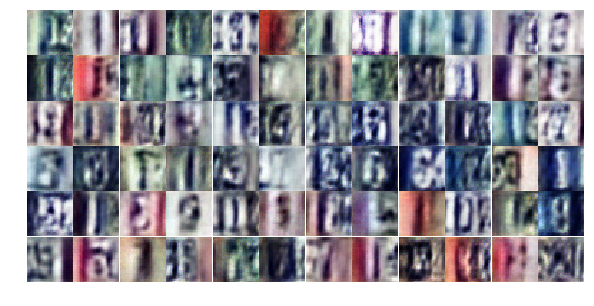

Epoch 4/25... Discriminator Loss: 0.3445... Generator Loss: 1.7915
Epoch 4/25... Discriminator Loss: 0.2221... Generator Loss: 2.3106
Epoch 4/25... Discriminator Loss: 0.8042... Generator Loss: 1.0213
Epoch 4/25... Discriminator Loss: 0.5000... Generator Loss: 1.3758
Epoch 4/25... Discriminator Loss: 0.2675... Generator Loss: 2.2913
Epoch 4/25... Discriminator Loss: 0.4468... Generator Loss: 2.6407
Epoch 4/25... Discriminator Loss: 0.5234... Generator Loss: 1.7757
Epoch 4/25... Discriminator Loss: 0.6420... Generator Loss: 1.7457
Epoch 4/25... Discriminator Loss: 0.2861... Generator Loss: 2.3865
Epoch 4/25... Discriminator Loss: 0.5209... Generator Loss: 2.7463


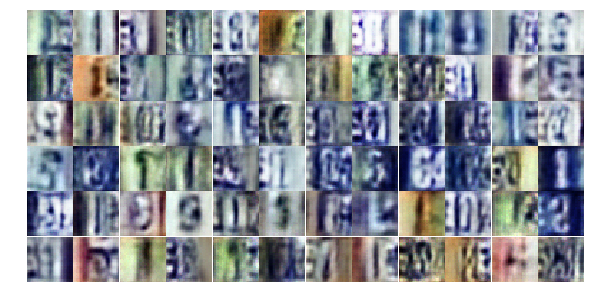

Epoch 4/25... Discriminator Loss: 1.1094... Generator Loss: 0.6637
Epoch 4/25... Discriminator Loss: 0.2126... Generator Loss: 2.1523
Epoch 4/25... Discriminator Loss: 0.1741... Generator Loss: 2.8661
Epoch 4/25... Discriminator Loss: 0.2464... Generator Loss: 2.4755
Epoch 4/25... Discriminator Loss: 1.6816... Generator Loss: 0.3212
Epoch 4/25... Discriminator Loss: 0.6587... Generator Loss: 2.0258
Epoch 4/25... Discriminator Loss: 0.5969... Generator Loss: 1.4527
Epoch 4/25... Discriminator Loss: 0.7890... Generator Loss: 0.9370
Epoch 4/25... Discriminator Loss: 0.4946... Generator Loss: 1.7794
Epoch 5/25... Discriminator Loss: 0.4229... Generator Loss: 1.7538


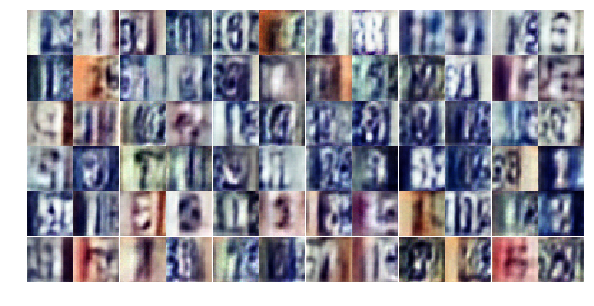

Epoch 5/25... Discriminator Loss: 0.3714... Generator Loss: 2.2967
Epoch 5/25... Discriminator Loss: 0.3132... Generator Loss: 2.4399
Epoch 5/25... Discriminator Loss: 0.4576... Generator Loss: 1.8928
Epoch 5/25... Discriminator Loss: 1.0346... Generator Loss: 0.5999
Epoch 5/25... Discriminator Loss: 0.2448... Generator Loss: 2.1766
Epoch 5/25... Discriminator Loss: 0.6650... Generator Loss: 0.9748
Epoch 5/25... Discriminator Loss: 0.4035... Generator Loss: 2.1010
Epoch 5/25... Discriminator Loss: 0.7159... Generator Loss: 0.9541
Epoch 5/25... Discriminator Loss: 0.7811... Generator Loss: 0.7987
Epoch 5/25... Discriminator Loss: 0.9198... Generator Loss: 1.3294


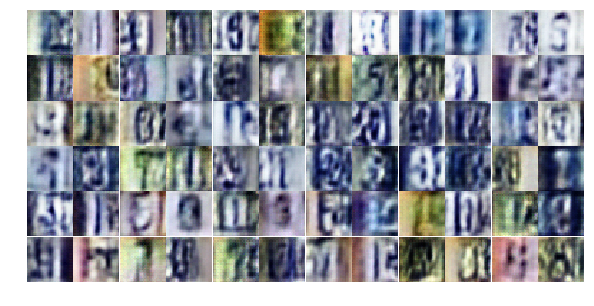

Epoch 5/25... Discriminator Loss: 0.4239... Generator Loss: 1.5929
Epoch 5/25... Discriminator Loss: 0.3205... Generator Loss: 1.9227
Epoch 5/25... Discriminator Loss: 0.4715... Generator Loss: 1.4264
Epoch 5/25... Discriminator Loss: 0.6006... Generator Loss: 1.0753
Epoch 5/25... Discriminator Loss: 0.5997... Generator Loss: 1.0525
Epoch 5/25... Discriminator Loss: 0.4756... Generator Loss: 1.2974
Epoch 5/25... Discriminator Loss: 0.4564... Generator Loss: 1.6783
Epoch 5/25... Discriminator Loss: 0.5033... Generator Loss: 1.6963
Epoch 5/25... Discriminator Loss: 0.6046... Generator Loss: 2.1511
Epoch 5/25... Discriminator Loss: 0.5463... Generator Loss: 1.3914


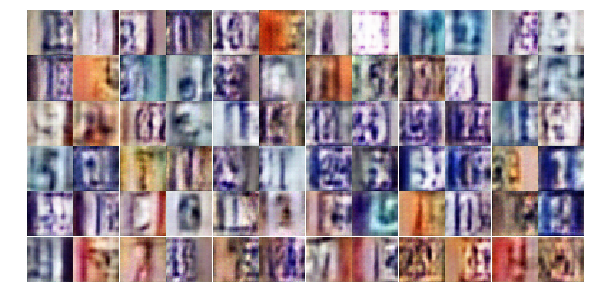

Epoch 5/25... Discriminator Loss: 0.6363... Generator Loss: 1.0385
Epoch 5/25... Discriminator Loss: 0.4195... Generator Loss: 2.4788
Epoch 5/25... Discriminator Loss: 0.4723... Generator Loss: 1.4450
Epoch 5/25... Discriminator Loss: 0.4872... Generator Loss: 1.5378
Epoch 5/25... Discriminator Loss: 1.0085... Generator Loss: 0.5933
Epoch 5/25... Discriminator Loss: 0.4520... Generator Loss: 1.3608
Epoch 5/25... Discriminator Loss: 1.2250... Generator Loss: 0.4931
Epoch 5/25... Discriminator Loss: 1.6211... Generator Loss: 0.3804
Epoch 5/25... Discriminator Loss: 1.0047... Generator Loss: 0.7389
Epoch 5/25... Discriminator Loss: 0.4743... Generator Loss: 1.4361


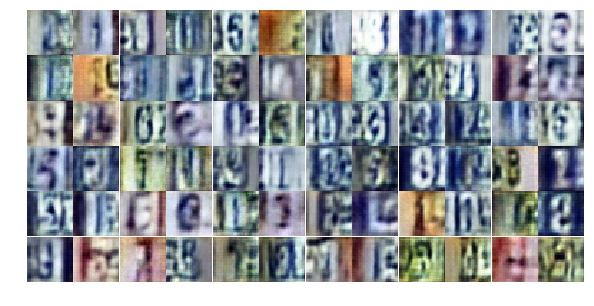

Epoch 5/25... Discriminator Loss: 0.6810... Generator Loss: 1.1029
Epoch 5/25... Discriminator Loss: 0.3684... Generator Loss: 1.7064
Epoch 5/25... Discriminator Loss: 0.3014... Generator Loss: 2.0374
Epoch 5/25... Discriminator Loss: 0.6610... Generator Loss: 0.9421
Epoch 5/25... Discriminator Loss: 0.3878... Generator Loss: 1.6976
Epoch 5/25... Discriminator Loss: 0.3596... Generator Loss: 1.8994
Epoch 5/25... Discriminator Loss: 0.5132... Generator Loss: 1.4159
Epoch 5/25... Discriminator Loss: 0.6747... Generator Loss: 0.9917
Epoch 5/25... Discriminator Loss: 0.7140... Generator Loss: 0.9206
Epoch 5/25... Discriminator Loss: 0.3077... Generator Loss: 2.0338


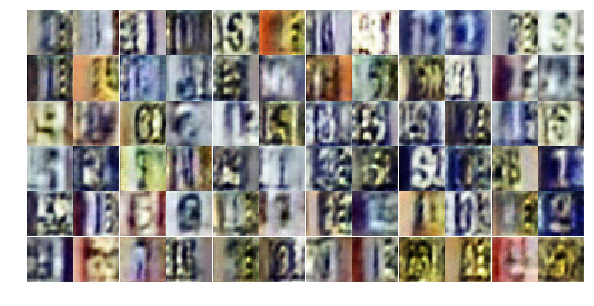

Epoch 5/25... Discriminator Loss: 0.2522... Generator Loss: 2.3972
Epoch 5/25... Discriminator Loss: 0.3569... Generator Loss: 2.0514
Epoch 5/25... Discriminator Loss: 1.2976... Generator Loss: 0.4666
Epoch 5/25... Discriminator Loss: 0.5345... Generator Loss: 1.4866
Epoch 5/25... Discriminator Loss: 1.0229... Generator Loss: 0.6459
Epoch 5/25... Discriminator Loss: 1.3441... Generator Loss: 0.4359
Epoch 5/25... Discriminator Loss: 0.5170... Generator Loss: 1.3318
Epoch 5/25... Discriminator Loss: 0.4838... Generator Loss: 1.6145
Epoch 5/25... Discriminator Loss: 0.4710... Generator Loss: 2.3497
Epoch 5/25... Discriminator Loss: 0.6465... Generator Loss: 3.1119


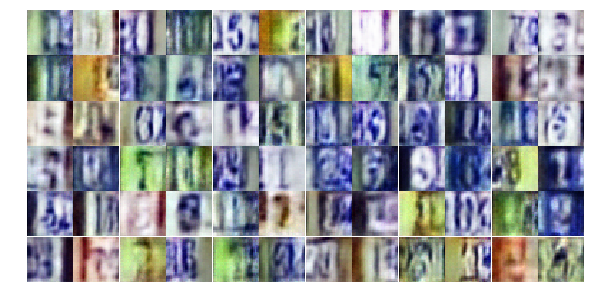

Epoch 5/25... Discriminator Loss: 0.7938... Generator Loss: 2.6136
Epoch 5/25... Discriminator Loss: 0.6348... Generator Loss: 1.5678
Epoch 5/25... Discriminator Loss: 0.6546... Generator Loss: 1.0617
Epoch 5/25... Discriminator Loss: 0.3625... Generator Loss: 1.7732
Epoch 5/25... Discriminator Loss: 0.3587... Generator Loss: 1.7032
Epoch 5/25... Discriminator Loss: 0.5433... Generator Loss: 1.7062
Epoch 6/25... Discriminator Loss: 0.6449... Generator Loss: 0.9698
Epoch 6/25... Discriminator Loss: 0.4329... Generator Loss: 1.4595
Epoch 6/25... Discriminator Loss: 0.2944... Generator Loss: 2.1403
Epoch 6/25... Discriminator Loss: 0.5134... Generator Loss: 1.2148


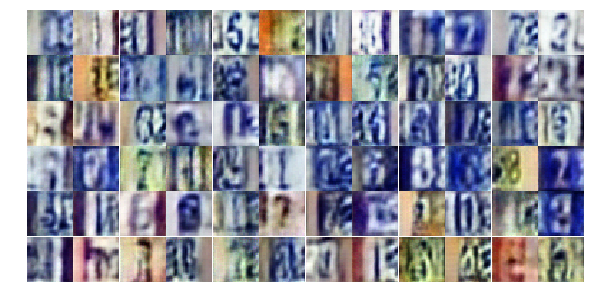

Epoch 6/25... Discriminator Loss: 0.4800... Generator Loss: 1.3448
Epoch 6/25... Discriminator Loss: 0.5958... Generator Loss: 1.1064
Epoch 6/25... Discriminator Loss: 3.5273... Generator Loss: 4.9531
Epoch 6/25... Discriminator Loss: 1.0411... Generator Loss: 0.7301
Epoch 6/25... Discriminator Loss: 1.1293... Generator Loss: 0.5429
Epoch 6/25... Discriminator Loss: 0.5598... Generator Loss: 1.1942
Epoch 6/25... Discriminator Loss: 0.4313... Generator Loss: 1.9451
Epoch 6/25... Discriminator Loss: 1.2051... Generator Loss: 0.4809
Epoch 6/25... Discriminator Loss: 0.6826... Generator Loss: 1.1032
Epoch 6/25... Discriminator Loss: 0.6167... Generator Loss: 1.8422


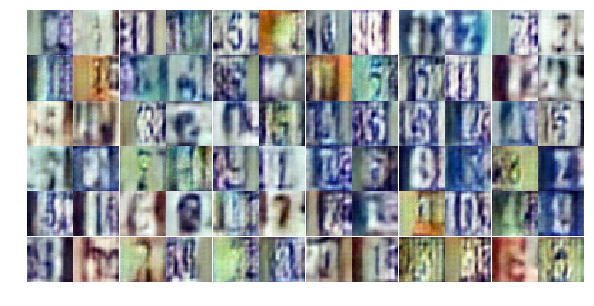

Epoch 6/25... Discriminator Loss: 0.4258... Generator Loss: 2.0219
Epoch 6/25... Discriminator Loss: 0.5628... Generator Loss: 1.3882
Epoch 6/25... Discriminator Loss: 0.5179... Generator Loss: 1.1907
Epoch 6/25... Discriminator Loss: 0.7120... Generator Loss: 0.9474
Epoch 6/25... Discriminator Loss: 0.4540... Generator Loss: 2.8604
Epoch 6/25... Discriminator Loss: 0.4688... Generator Loss: 1.6518
Epoch 6/25... Discriminator Loss: 0.4373... Generator Loss: 1.6483
Epoch 6/25... Discriminator Loss: 0.6848... Generator Loss: 1.1601
Epoch 6/25... Discriminator Loss: 0.7553... Generator Loss: 2.1544
Epoch 6/25... Discriminator Loss: 0.6349... Generator Loss: 0.9777


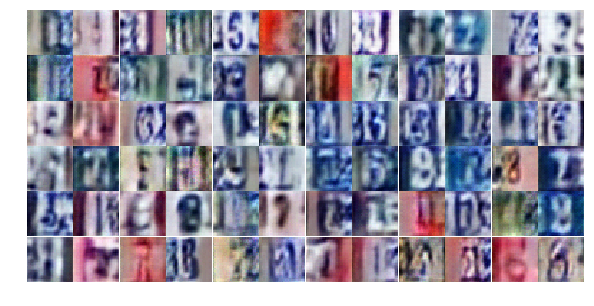

Epoch 6/25... Discriminator Loss: 0.8370... Generator Loss: 0.7468
Epoch 6/25... Discriminator Loss: 0.7779... Generator Loss: 0.8052
Epoch 6/25... Discriminator Loss: 0.7330... Generator Loss: 1.0174
Epoch 6/25... Discriminator Loss: 0.5744... Generator Loss: 1.2736
Epoch 6/25... Discriminator Loss: 0.3354... Generator Loss: 1.9939
Epoch 6/25... Discriminator Loss: 1.2623... Generator Loss: 0.5643
Epoch 6/25... Discriminator Loss: 0.5031... Generator Loss: 1.6214
Epoch 6/25... Discriminator Loss: 0.4165... Generator Loss: 1.6953
Epoch 6/25... Discriminator Loss: 0.4894... Generator Loss: 1.5452
Epoch 6/25... Discriminator Loss: 0.3942... Generator Loss: 1.7155


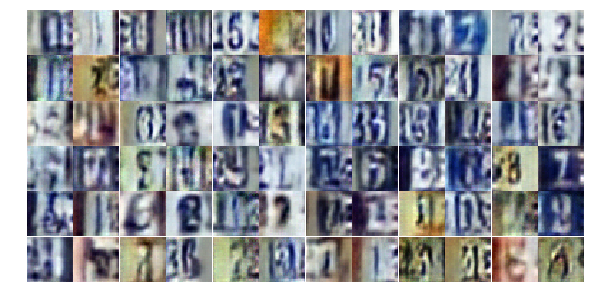

Epoch 6/25... Discriminator Loss: 0.4841... Generator Loss: 1.6222
Epoch 6/25... Discriminator Loss: 0.7078... Generator Loss: 0.9375
Epoch 6/25... Discriminator Loss: 0.8686... Generator Loss: 0.7356
Epoch 6/25... Discriminator Loss: 0.3359... Generator Loss: 1.7761
Epoch 6/25... Discriminator Loss: 0.5940... Generator Loss: 1.2424
Epoch 6/25... Discriminator Loss: 0.4225... Generator Loss: 1.4089
Epoch 6/25... Discriminator Loss: 0.9455... Generator Loss: 0.7738
Epoch 6/25... Discriminator Loss: 0.6091... Generator Loss: 1.7807
Epoch 6/25... Discriminator Loss: 0.8914... Generator Loss: 0.7634
Epoch 6/25... Discriminator Loss: 0.7408... Generator Loss: 0.8770


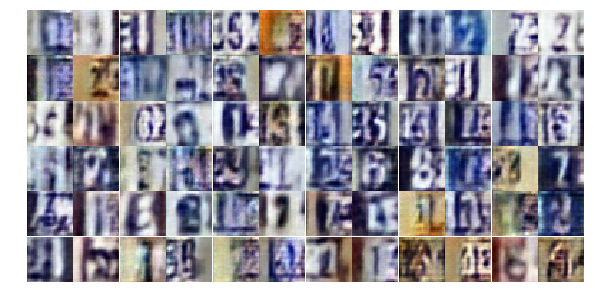

Epoch 6/25... Discriminator Loss: 1.2324... Generator Loss: 0.5633
Epoch 6/25... Discriminator Loss: 0.6253... Generator Loss: 1.6023
Epoch 6/25... Discriminator Loss: 0.6750... Generator Loss: 1.1716
Epoch 6/25... Discriminator Loss: 0.4171... Generator Loss: 1.7120
Epoch 6/25... Discriminator Loss: 0.4969... Generator Loss: 1.3978
Epoch 6/25... Discriminator Loss: 0.3868... Generator Loss: 1.6283
Epoch 6/25... Discriminator Loss: 0.6743... Generator Loss: 0.9873
Epoch 6/25... Discriminator Loss: 1.4001... Generator Loss: 0.3755
Epoch 6/25... Discriminator Loss: 1.2546... Generator Loss: 0.6189
Epoch 6/25... Discriminator Loss: 1.6035... Generator Loss: 0.3451


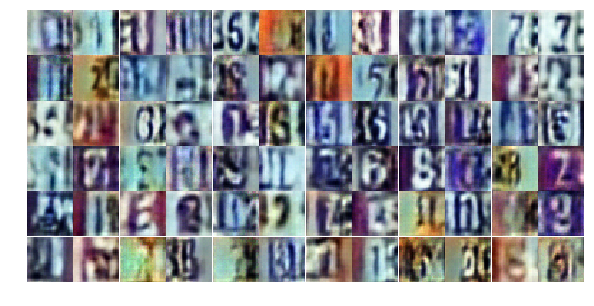

Epoch 6/25... Discriminator Loss: 0.3908... Generator Loss: 1.8140
Epoch 6/25... Discriminator Loss: 0.5711... Generator Loss: 1.1203
Epoch 6/25... Discriminator Loss: 0.5084... Generator Loss: 1.3607
Epoch 7/25... Discriminator Loss: 0.4817... Generator Loss: 1.8147
Epoch 7/25... Discriminator Loss: 0.6497... Generator Loss: 1.1868
Epoch 7/25... Discriminator Loss: 0.4330... Generator Loss: 3.3099
Epoch 7/25... Discriminator Loss: 0.4630... Generator Loss: 1.4433
Epoch 7/25... Discriminator Loss: 0.3226... Generator Loss: 1.9827
Epoch 7/25... Discriminator Loss: 0.2615... Generator Loss: 2.0417
Epoch 7/25... Discriminator Loss: 0.6122... Generator Loss: 1.0176


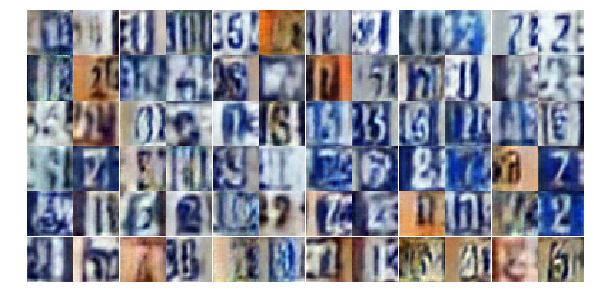

Epoch 7/25... Discriminator Loss: 0.4733... Generator Loss: 2.8991
Epoch 7/25... Discriminator Loss: 0.6595... Generator Loss: 1.3224
Epoch 7/25... Discriminator Loss: 0.5049... Generator Loss: 1.1907
Epoch 7/25... Discriminator Loss: 1.3273... Generator Loss: 3.6553
Epoch 7/25... Discriminator Loss: 0.4839... Generator Loss: 2.3085
Epoch 7/25... Discriminator Loss: 0.3863... Generator Loss: 1.8030
Epoch 7/25... Discriminator Loss: 1.0033... Generator Loss: 2.0857
Epoch 7/25... Discriminator Loss: 1.0343... Generator Loss: 0.6698
Epoch 7/25... Discriminator Loss: 1.0111... Generator Loss: 3.4413
Epoch 7/25... Discriminator Loss: 0.3623... Generator Loss: 1.7345


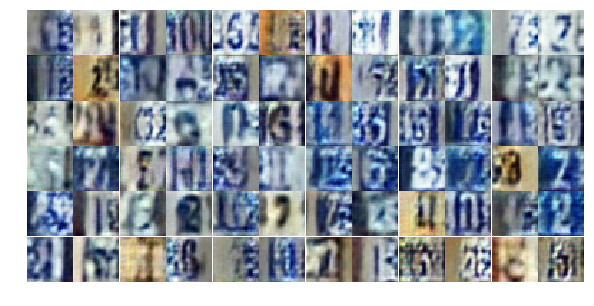

Epoch 7/25... Discriminator Loss: 0.6201... Generator Loss: 1.2052
Epoch 7/25... Discriminator Loss: 0.3714... Generator Loss: 1.5827
Epoch 7/25... Discriminator Loss: 0.7798... Generator Loss: 0.8372
Epoch 7/25... Discriminator Loss: 0.4918... Generator Loss: 1.5709
Epoch 7/25... Discriminator Loss: 0.5828... Generator Loss: 1.6831
Epoch 7/25... Discriminator Loss: 0.3527... Generator Loss: 2.1218
Epoch 7/25... Discriminator Loss: 0.7756... Generator Loss: 0.8176
Epoch 7/25... Discriminator Loss: 1.0207... Generator Loss: 0.6780
Epoch 7/25... Discriminator Loss: 0.3204... Generator Loss: 1.9433
Epoch 7/25... Discriminator Loss: 0.5091... Generator Loss: 3.5524


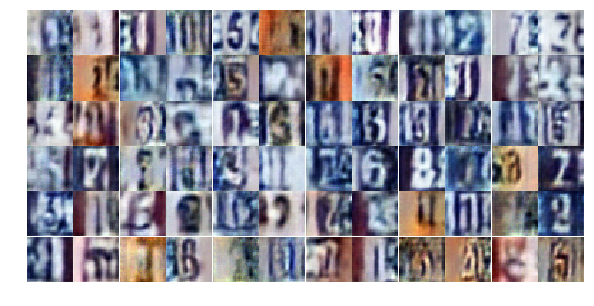

Epoch 7/25... Discriminator Loss: 1.0265... Generator Loss: 0.6564
Epoch 7/25... Discriminator Loss: 1.1298... Generator Loss: 0.4967
Epoch 7/25... Discriminator Loss: 0.3718... Generator Loss: 1.7995
Epoch 7/25... Discriminator Loss: 0.7000... Generator Loss: 0.9460
Epoch 7/25... Discriminator Loss: 0.5612... Generator Loss: 1.9204
Epoch 7/25... Discriminator Loss: 0.9815... Generator Loss: 0.6470
Epoch 7/25... Discriminator Loss: 0.2772... Generator Loss: 2.0269
Epoch 7/25... Discriminator Loss: 1.0486... Generator Loss: 0.5630
Epoch 7/25... Discriminator Loss: 1.1534... Generator Loss: 0.4992
Epoch 7/25... Discriminator Loss: 0.6981... Generator Loss: 2.8392


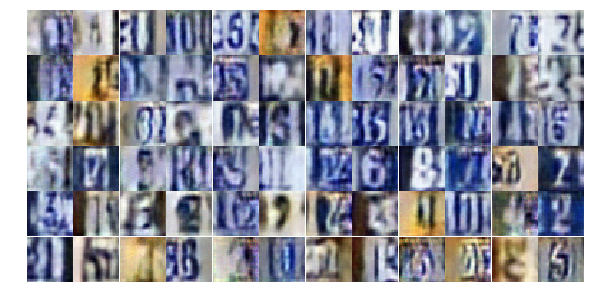

Epoch 7/25... Discriminator Loss: 1.2871... Generator Loss: 0.4800
Epoch 7/25... Discriminator Loss: 0.3880... Generator Loss: 1.7887
Epoch 7/25... Discriminator Loss: 0.7210... Generator Loss: 0.9263
Epoch 7/25... Discriminator Loss: 0.4672... Generator Loss: 1.8044
Epoch 7/25... Discriminator Loss: 0.7345... Generator Loss: 0.9540
Epoch 7/25... Discriminator Loss: 0.4696... Generator Loss: 1.3620
Epoch 7/25... Discriminator Loss: 0.5223... Generator Loss: 1.3183
Epoch 7/25... Discriminator Loss: 1.0221... Generator Loss: 0.6111
Epoch 7/25... Discriminator Loss: 0.5536... Generator Loss: 3.1002
Epoch 7/25... Discriminator Loss: 2.4964... Generator Loss: 3.0298


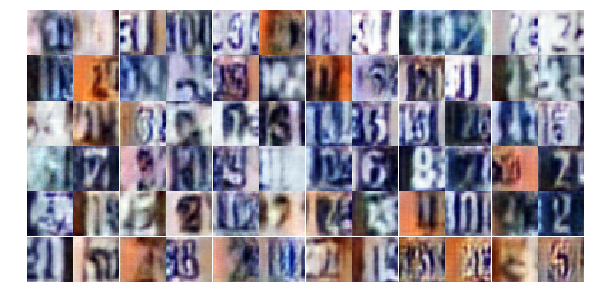

Epoch 7/25... Discriminator Loss: 0.3017... Generator Loss: 2.0912
Epoch 7/25... Discriminator Loss: 0.4356... Generator Loss: 1.6106
Epoch 7/25... Discriminator Loss: 0.5162... Generator Loss: 1.3000
Epoch 7/25... Discriminator Loss: 0.6738... Generator Loss: 1.7162
Epoch 7/25... Discriminator Loss: 0.7267... Generator Loss: 0.9304
Epoch 7/25... Discriminator Loss: 1.0307... Generator Loss: 0.8581
Epoch 7/25... Discriminator Loss: 0.9080... Generator Loss: 1.8735
Epoch 7/25... Discriminator Loss: 0.6114... Generator Loss: 2.0196
Epoch 7/25... Discriminator Loss: 0.6642... Generator Loss: 1.5254
Epoch 7/25... Discriminator Loss: 0.9085... Generator Loss: 0.7201


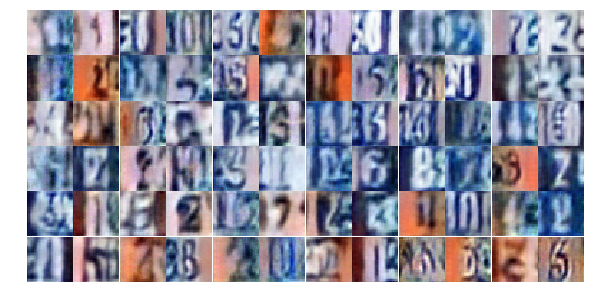

Epoch 7/25... Discriminator Loss: 0.5658... Generator Loss: 1.3253
Epoch 8/25... Discriminator Loss: 0.7361... Generator Loss: 0.8649
Epoch 8/25... Discriminator Loss: 0.6955... Generator Loss: 0.8783
Epoch 8/25... Discriminator Loss: 0.7877... Generator Loss: 0.8939
Epoch 8/25... Discriminator Loss: 0.8253... Generator Loss: 2.7020
Epoch 8/25... Discriminator Loss: 0.6904... Generator Loss: 1.0309
Epoch 8/25... Discriminator Loss: 0.8947... Generator Loss: 1.2407
Epoch 8/25... Discriminator Loss: 0.9183... Generator Loss: 3.4744
Epoch 8/25... Discriminator Loss: 1.3510... Generator Loss: 0.4212
Epoch 8/25... Discriminator Loss: 0.8096... Generator Loss: 0.8604


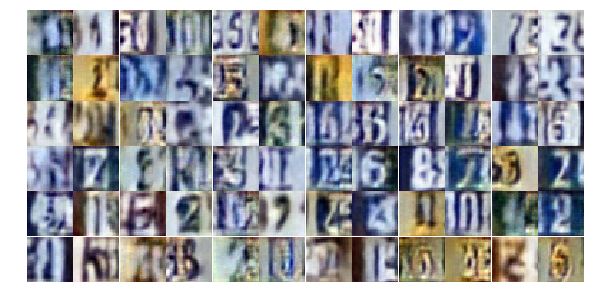

Epoch 8/25... Discriminator Loss: 0.5134... Generator Loss: 1.4780
Epoch 8/25... Discriminator Loss: 0.4091... Generator Loss: 1.4936
Epoch 8/25... Discriminator Loss: 0.7964... Generator Loss: 0.8279
Epoch 8/25... Discriminator Loss: 0.4465... Generator Loss: 1.6096
Epoch 8/25... Discriminator Loss: 0.3877... Generator Loss: 2.3167
Epoch 8/25... Discriminator Loss: 0.5942... Generator Loss: 1.5622
Epoch 8/25... Discriminator Loss: 0.5047... Generator Loss: 1.3238
Epoch 8/25... Discriminator Loss: 0.6267... Generator Loss: 1.0777
Epoch 8/25... Discriminator Loss: 0.9628... Generator Loss: 0.6939
Epoch 8/25... Discriminator Loss: 1.1935... Generator Loss: 0.5218


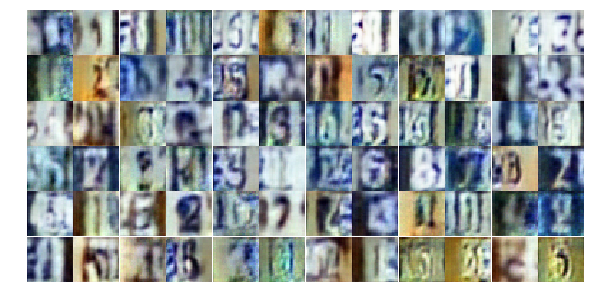

Epoch 8/25... Discriminator Loss: 0.4059... Generator Loss: 1.9771
Epoch 8/25... Discriminator Loss: 0.5803... Generator Loss: 1.1671
Epoch 8/25... Discriminator Loss: 0.6689... Generator Loss: 1.0990
Epoch 8/25... Discriminator Loss: 0.7431... Generator Loss: 1.0012
Epoch 8/25... Discriminator Loss: 0.3379... Generator Loss: 1.7722
Epoch 8/25... Discriminator Loss: 0.4648... Generator Loss: 1.5015
Epoch 8/25... Discriminator Loss: 0.6488... Generator Loss: 1.1755
Epoch 8/25... Discriminator Loss: 0.3560... Generator Loss: 1.6262
Epoch 8/25... Discriminator Loss: 0.6582... Generator Loss: 1.1914
Epoch 8/25... Discriminator Loss: 0.5273... Generator Loss: 1.2860


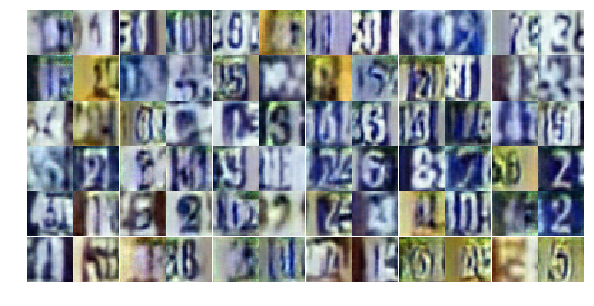

Epoch 8/25... Discriminator Loss: 3.4520... Generator Loss: 4.5304
Epoch 8/25... Discriminator Loss: 0.9264... Generator Loss: 0.8536
Epoch 8/25... Discriminator Loss: 0.5323... Generator Loss: 1.4964
Epoch 8/25... Discriminator Loss: 0.7352... Generator Loss: 0.9644
Epoch 8/25... Discriminator Loss: 1.3330... Generator Loss: 0.4674
Epoch 8/25... Discriminator Loss: 0.2882... Generator Loss: 1.9564
Epoch 8/25... Discriminator Loss: 0.4647... Generator Loss: 1.7326
Epoch 8/25... Discriminator Loss: 0.9490... Generator Loss: 0.6536
Epoch 8/25... Discriminator Loss: 0.5871... Generator Loss: 1.0959
Epoch 8/25... Discriminator Loss: 0.4907... Generator Loss: 1.5319


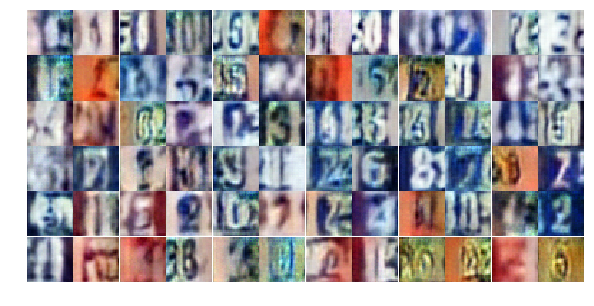

Epoch 8/25... Discriminator Loss: 0.4886... Generator Loss: 1.1931
Epoch 8/25... Discriminator Loss: 0.9481... Generator Loss: 0.6952
Epoch 8/25... Discriminator Loss: 0.4576... Generator Loss: 1.3562
Epoch 8/25... Discriminator Loss: 0.3933... Generator Loss: 2.0260
Epoch 8/25... Discriminator Loss: 0.5298... Generator Loss: 1.3344
Epoch 8/25... Discriminator Loss: 0.5483... Generator Loss: 1.2762
Epoch 8/25... Discriminator Loss: 0.4753... Generator Loss: 1.2626
Epoch 8/25... Discriminator Loss: 0.4807... Generator Loss: 3.1406
Epoch 8/25... Discriminator Loss: 1.1891... Generator Loss: 0.4707
Epoch 8/25... Discriminator Loss: 0.9750... Generator Loss: 0.9086


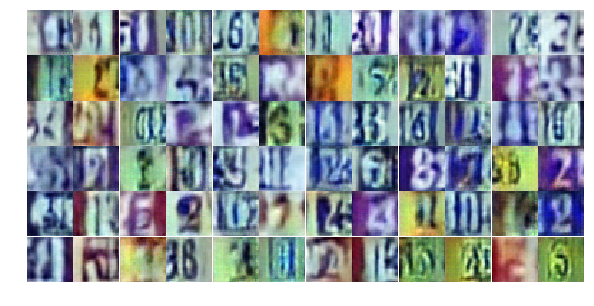

Epoch 8/25... Discriminator Loss: 0.6344... Generator Loss: 1.1702
Epoch 8/25... Discriminator Loss: 0.9549... Generator Loss: 0.6969
Epoch 8/25... Discriminator Loss: 0.4654... Generator Loss: 1.7487
Epoch 8/25... Discriminator Loss: 0.9333... Generator Loss: 0.6641
Epoch 8/25... Discriminator Loss: 0.3696... Generator Loss: 2.4803
Epoch 8/25... Discriminator Loss: 1.2514... Generator Loss: 0.4457
Epoch 8/25... Discriminator Loss: 0.5329... Generator Loss: 1.3318
Epoch 8/25... Discriminator Loss: 0.6018... Generator Loss: 1.4318
Epoch 9/25... Discriminator Loss: 0.6270... Generator Loss: 2.0660
Epoch 9/25... Discriminator Loss: 0.6067... Generator Loss: 1.0763


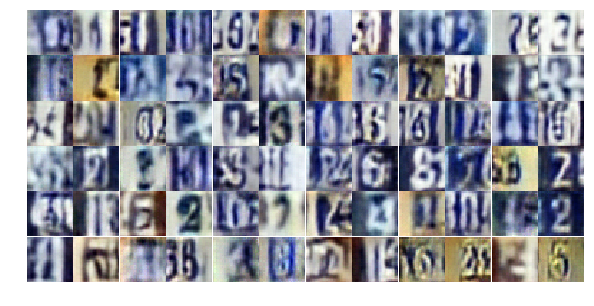

Epoch 9/25... Discriminator Loss: 0.8974... Generator Loss: 0.6899
Epoch 9/25... Discriminator Loss: 0.8846... Generator Loss: 2.0908
Epoch 9/25... Discriminator Loss: 1.5063... Generator Loss: 0.3630
Epoch 9/25... Discriminator Loss: 0.4241... Generator Loss: 1.5266
Epoch 9/25... Discriminator Loss: 0.9736... Generator Loss: 0.6840
Epoch 9/25... Discriminator Loss: 0.4014... Generator Loss: 2.0612
Epoch 9/25... Discriminator Loss: 0.5389... Generator Loss: 1.5920
Epoch 9/25... Discriminator Loss: 0.5763... Generator Loss: 1.2791
Epoch 9/25... Discriminator Loss: 0.6451... Generator Loss: 1.0261
Epoch 9/25... Discriminator Loss: 0.7319... Generator Loss: 1.5805


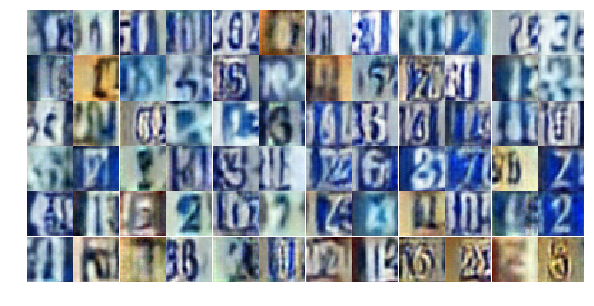

Epoch 9/25... Discriminator Loss: 0.6208... Generator Loss: 1.2555
Epoch 9/25... Discriminator Loss: 1.0731... Generator Loss: 0.5928
Epoch 9/25... Discriminator Loss: 0.5589... Generator Loss: 1.8219
Epoch 9/25... Discriminator Loss: 1.1999... Generator Loss: 0.5266
Epoch 9/25... Discriminator Loss: 0.5227... Generator Loss: 1.3115
Epoch 9/25... Discriminator Loss: 0.4899... Generator Loss: 1.6524
Epoch 9/25... Discriminator Loss: 1.3881... Generator Loss: 0.3780
Epoch 9/25... Discriminator Loss: 0.3723... Generator Loss: 1.8716
Epoch 9/25... Discriminator Loss: 1.0330... Generator Loss: 0.6120
Epoch 9/25... Discriminator Loss: 0.5389... Generator Loss: 1.2150


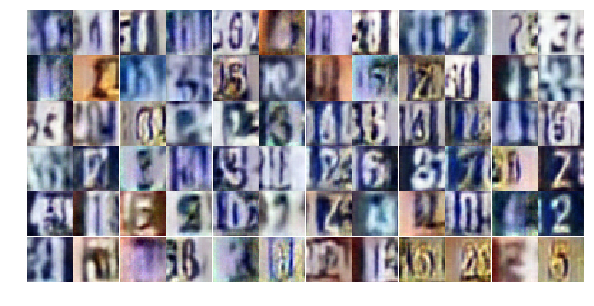

Epoch 9/25... Discriminator Loss: 0.7475... Generator Loss: 1.0997
Epoch 9/25... Discriminator Loss: 0.5744... Generator Loss: 1.0460
Epoch 9/25... Discriminator Loss: 0.5426... Generator Loss: 1.8805
Epoch 9/25... Discriminator Loss: 0.6587... Generator Loss: 1.2694
Epoch 9/25... Discriminator Loss: 0.4702... Generator Loss: 1.6503
Epoch 9/25... Discriminator Loss: 0.5659... Generator Loss: 1.5587
Epoch 9/25... Discriminator Loss: 0.8783... Generator Loss: 0.7669
Epoch 9/25... Discriminator Loss: 0.8512... Generator Loss: 2.6113
Epoch 9/25... Discriminator Loss: 0.8295... Generator Loss: 1.1880
Epoch 9/25... Discriminator Loss: 0.6027... Generator Loss: 1.2172


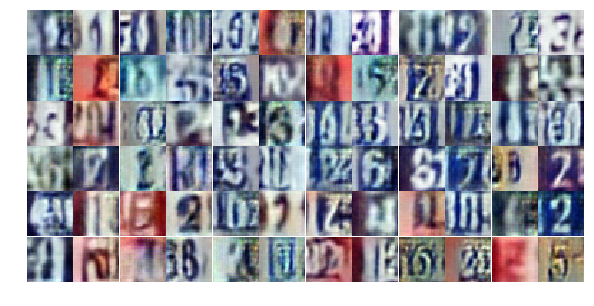

Epoch 9/25... Discriminator Loss: 0.5101... Generator Loss: 1.3143
Epoch 9/25... Discriminator Loss: 0.5899... Generator Loss: 1.3482
Epoch 9/25... Discriminator Loss: 0.9174... Generator Loss: 0.7023
Epoch 9/25... Discriminator Loss: 0.6389... Generator Loss: 1.0352
Epoch 9/25... Discriminator Loss: 0.6221... Generator Loss: 1.1510
Epoch 9/25... Discriminator Loss: 0.5328... Generator Loss: 1.6839
Epoch 9/25... Discriminator Loss: 0.5263... Generator Loss: 1.7083
Epoch 9/25... Discriminator Loss: 0.3815... Generator Loss: 1.4590
Epoch 9/25... Discriminator Loss: 0.7922... Generator Loss: 1.3149
Epoch 9/25... Discriminator Loss: 0.5350... Generator Loss: 1.3606


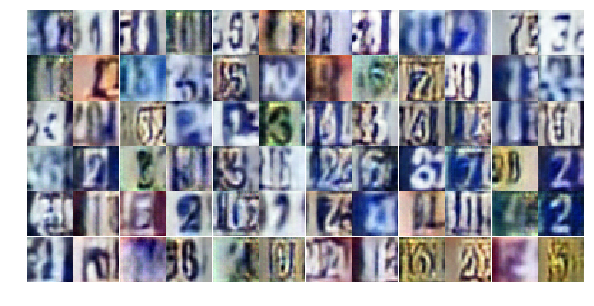

Epoch 9/25... Discriminator Loss: 0.6068... Generator Loss: 1.6100
Epoch 9/25... Discriminator Loss: 0.6259... Generator Loss: 1.0065
Epoch 9/25... Discriminator Loss: 0.6824... Generator Loss: 1.2087
Epoch 9/25... Discriminator Loss: 0.9291... Generator Loss: 1.4815
Epoch 9/25... Discriminator Loss: 0.4630... Generator Loss: 1.4098
Epoch 9/25... Discriminator Loss: 0.9512... Generator Loss: 0.6840
Epoch 9/25... Discriminator Loss: 0.7457... Generator Loss: 1.0039
Epoch 9/25... Discriminator Loss: 0.8698... Generator Loss: 0.7300
Epoch 9/25... Discriminator Loss: 0.6566... Generator Loss: 1.0924
Epoch 9/25... Discriminator Loss: 0.4036... Generator Loss: 2.3216


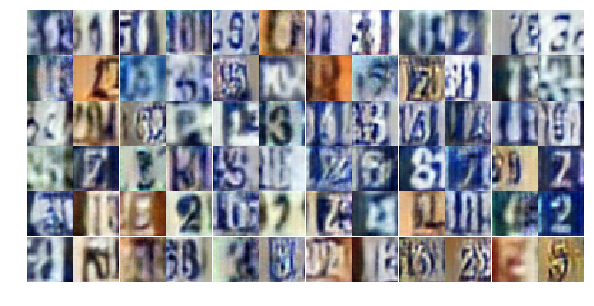

Epoch 9/25... Discriminator Loss: 1.0690... Generator Loss: 0.5601
Epoch 9/25... Discriminator Loss: 0.6186... Generator Loss: 1.8886
Epoch 9/25... Discriminator Loss: 0.5009... Generator Loss: 1.3890
Epoch 9/25... Discriminator Loss: 1.1239... Generator Loss: 0.5524
Epoch 9/25... Discriminator Loss: 0.5495... Generator Loss: 1.2090
Epoch 10/25... Discriminator Loss: 1.1728... Generator Loss: 0.4966
Epoch 10/25... Discriminator Loss: 0.5298... Generator Loss: 1.3726
Epoch 10/25... Discriminator Loss: 0.5614... Generator Loss: 1.2681
Epoch 10/25... Discriminator Loss: 0.7017... Generator Loss: 0.9857
Epoch 10/25... Discriminator Loss: 0.8693... Generator Loss: 0.7440


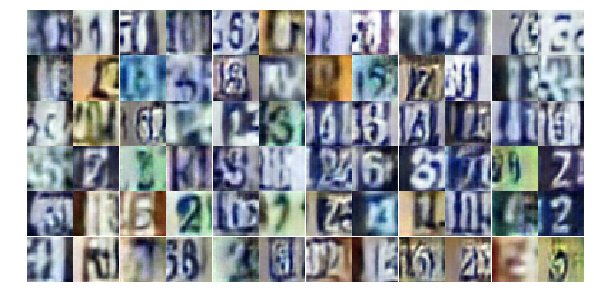

Epoch 10/25... Discriminator Loss: 0.5844... Generator Loss: 1.1996
Epoch 10/25... Discriminator Loss: 0.8849... Generator Loss: 4.3789
Epoch 10/25... Discriminator Loss: 1.0947... Generator Loss: 0.6005
Epoch 10/25... Discriminator Loss: 0.5988... Generator Loss: 1.5322
Epoch 10/25... Discriminator Loss: 0.6198... Generator Loss: 1.3593
Epoch 10/25... Discriminator Loss: 0.6736... Generator Loss: 1.1308
Epoch 10/25... Discriminator Loss: 0.7877... Generator Loss: 0.8162
Epoch 10/25... Discriminator Loss: 0.8060... Generator Loss: 0.7834
Epoch 10/25... Discriminator Loss: 0.7656... Generator Loss: 1.5173
Epoch 10/25... Discriminator Loss: 0.6097... Generator Loss: 1.3315


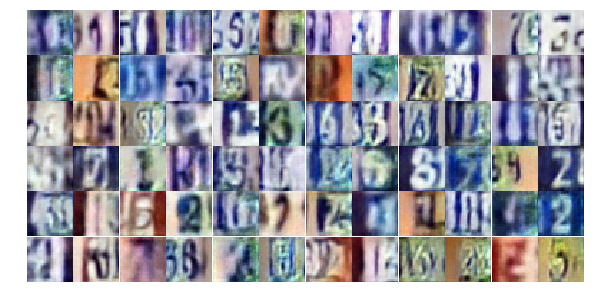

Epoch 10/25... Discriminator Loss: 0.5933... Generator Loss: 1.5187
Epoch 10/25... Discriminator Loss: 0.7989... Generator Loss: 1.0125
Epoch 10/25... Discriminator Loss: 0.6907... Generator Loss: 1.1968
Epoch 10/25... Discriminator Loss: 1.0823... Generator Loss: 0.5687
Epoch 10/25... Discriminator Loss: 0.5896... Generator Loss: 1.1400
Epoch 10/25... Discriminator Loss: 0.5546... Generator Loss: 1.2248
Epoch 10/25... Discriminator Loss: 0.7186... Generator Loss: 0.9227
Epoch 10/25... Discriminator Loss: 0.6605... Generator Loss: 1.0491
Epoch 10/25... Discriminator Loss: 0.6400... Generator Loss: 1.0139
Epoch 10/25... Discriminator Loss: 0.3880... Generator Loss: 2.0965


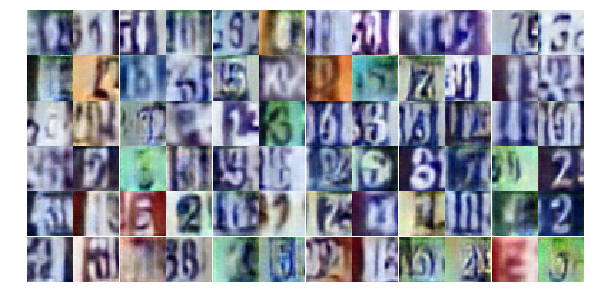

Epoch 10/25... Discriminator Loss: 1.0646... Generator Loss: 0.5713
Epoch 10/25... Discriminator Loss: 0.6037... Generator Loss: 1.0784
Epoch 10/25... Discriminator Loss: 0.4393... Generator Loss: 1.2900
Epoch 10/25... Discriminator Loss: 0.6045... Generator Loss: 2.6368
Epoch 10/25... Discriminator Loss: 1.3993... Generator Loss: 0.3788
Epoch 10/25... Discriminator Loss: 0.6205... Generator Loss: 1.2808
Epoch 10/25... Discriminator Loss: 0.3659... Generator Loss: 1.5358
Epoch 10/25... Discriminator Loss: 0.5083... Generator Loss: 1.3976
Epoch 10/25... Discriminator Loss: 0.6792... Generator Loss: 0.9882
Epoch 10/25... Discriminator Loss: 0.7339... Generator Loss: 1.0933


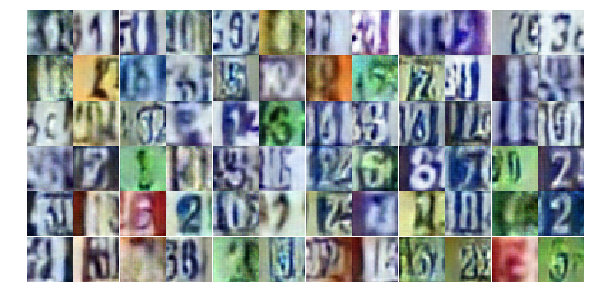

Epoch 10/25... Discriminator Loss: 0.6420... Generator Loss: 1.1050
Epoch 10/25... Discriminator Loss: 1.2002... Generator Loss: 0.6818
Epoch 10/25... Discriminator Loss: 0.4812... Generator Loss: 2.1848
Epoch 10/25... Discriminator Loss: 0.6490... Generator Loss: 2.2370
Epoch 10/25... Discriminator Loss: 0.9205... Generator Loss: 0.7174
Epoch 10/25... Discriminator Loss: 1.0909... Generator Loss: 0.5344
Epoch 10/25... Discriminator Loss: 0.6800... Generator Loss: 1.2899
Epoch 10/25... Discriminator Loss: 0.9746... Generator Loss: 0.6746
Epoch 10/25... Discriminator Loss: 0.5755... Generator Loss: 1.1297
Epoch 10/25... Discriminator Loss: 0.4761... Generator Loss: 1.5695


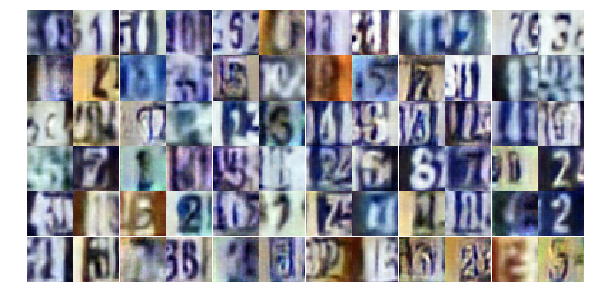

Epoch 10/25... Discriminator Loss: 0.6368... Generator Loss: 1.0213
Epoch 10/25... Discriminator Loss: 1.0403... Generator Loss: 3.0742
Epoch 10/25... Discriminator Loss: 0.7506... Generator Loss: 0.9995
Epoch 10/25... Discriminator Loss: 0.7266... Generator Loss: 1.1483
Epoch 10/25... Discriminator Loss: 0.5185... Generator Loss: 1.4183
Epoch 10/25... Discriminator Loss: 0.7364... Generator Loss: 0.9870
Epoch 10/25... Discriminator Loss: 0.5568... Generator Loss: 1.1979
Epoch 10/25... Discriminator Loss: 0.7285... Generator Loss: 0.9139
Epoch 10/25... Discriminator Loss: 0.7057... Generator Loss: 2.1142
Epoch 10/25... Discriminator Loss: 0.4023... Generator Loss: 1.7626


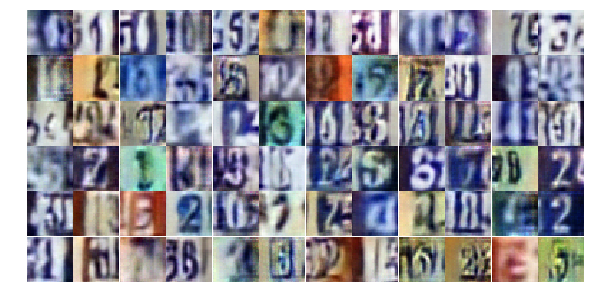

Epoch 10/25... Discriminator Loss: 0.7037... Generator Loss: 1.2854
Epoch 10/25... Discriminator Loss: 0.6561... Generator Loss: 1.1207
Epoch 10/25... Discriminator Loss: 0.4160... Generator Loss: 1.4234
Epoch 11/25... Discriminator Loss: 0.6852... Generator Loss: 1.1040
Epoch 11/25... Discriminator Loss: 0.6973... Generator Loss: 0.9292
Epoch 11/25... Discriminator Loss: 1.2722... Generator Loss: 0.4754
Epoch 11/25... Discriminator Loss: 0.8447... Generator Loss: 0.7490
Epoch 11/25... Discriminator Loss: 0.4823... Generator Loss: 1.8552
Epoch 11/25... Discriminator Loss: 1.7496... Generator Loss: 0.3071
Epoch 11/25... Discriminator Loss: 0.8103... Generator Loss: 0.9326


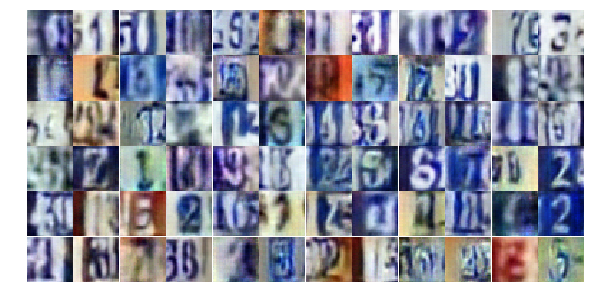

Epoch 11/25... Discriminator Loss: 0.5412... Generator Loss: 1.4083
Epoch 11/25... Discriminator Loss: 0.6654... Generator Loss: 0.9705
Epoch 11/25... Discriminator Loss: 0.4141... Generator Loss: 1.7146
Epoch 11/25... Discriminator Loss: 0.6608... Generator Loss: 0.9988
Epoch 11/25... Discriminator Loss: 0.8992... Generator Loss: 0.8277
Epoch 11/25... Discriminator Loss: 0.4116... Generator Loss: 2.2399
Epoch 11/25... Discriminator Loss: 0.6746... Generator Loss: 1.1179
Epoch 11/25... Discriminator Loss: 0.3537... Generator Loss: 1.7202
Epoch 11/25... Discriminator Loss: 0.5388... Generator Loss: 1.3066
Epoch 11/25... Discriminator Loss: 1.1710... Generator Loss: 0.6095


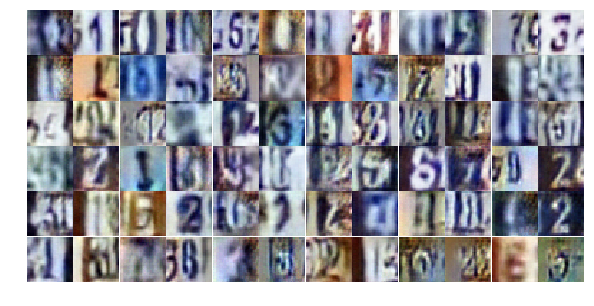

Epoch 11/25... Discriminator Loss: 0.6388... Generator Loss: 1.0701
Epoch 11/25... Discriminator Loss: 0.6239... Generator Loss: 2.2964
Epoch 11/25... Discriminator Loss: 1.4771... Generator Loss: 0.3755
Epoch 11/25... Discriminator Loss: 0.8027... Generator Loss: 0.7962
Epoch 11/25... Discriminator Loss: 0.4109... Generator Loss: 2.4569
Epoch 11/25... Discriminator Loss: 0.3138... Generator Loss: 1.9864
Epoch 11/25... Discriminator Loss: 0.4260... Generator Loss: 1.4227
Epoch 11/25... Discriminator Loss: 1.0108... Generator Loss: 0.6459
Epoch 11/25... Discriminator Loss: 0.3858... Generator Loss: 1.5348
Epoch 11/25... Discriminator Loss: 0.9558... Generator Loss: 0.6546


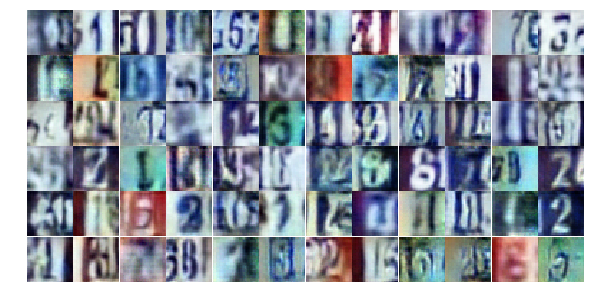

Epoch 11/25... Discriminator Loss: 0.6803... Generator Loss: 1.0047
Epoch 11/25... Discriminator Loss: 0.6945... Generator Loss: 0.9549
Epoch 11/25... Discriminator Loss: 0.9794... Generator Loss: 0.7304
Epoch 11/25... Discriminator Loss: 0.3664... Generator Loss: 1.8418
Epoch 11/25... Discriminator Loss: 0.7666... Generator Loss: 0.9094
Epoch 11/25... Discriminator Loss: 1.2894... Generator Loss: 0.4184
Epoch 11/25... Discriminator Loss: 0.7870... Generator Loss: 2.8218
Epoch 11/25... Discriminator Loss: 0.8652... Generator Loss: 0.8999
Epoch 11/25... Discriminator Loss: 0.5107... Generator Loss: 1.3289
Epoch 11/25... Discriminator Loss: 1.1017... Generator Loss: 0.5957


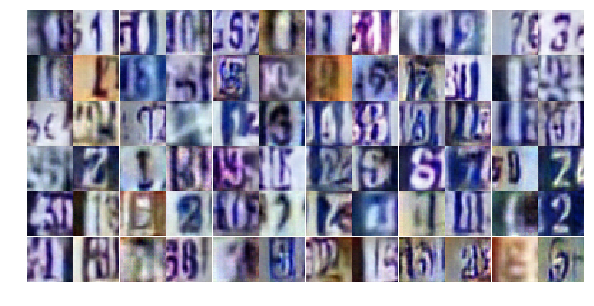

Epoch 11/25... Discriminator Loss: 0.6789... Generator Loss: 1.1285
Epoch 11/25... Discriminator Loss: 0.4910... Generator Loss: 1.5194
Epoch 11/25... Discriminator Loss: 0.5915... Generator Loss: 1.4072
Epoch 11/25... Discriminator Loss: 0.6489... Generator Loss: 1.1487
Epoch 11/25... Discriminator Loss: 0.8131... Generator Loss: 0.7606
Epoch 11/25... Discriminator Loss: 0.7546... Generator Loss: 0.8552
Epoch 11/25... Discriminator Loss: 0.3499... Generator Loss: 2.1026
Epoch 11/25... Discriminator Loss: 0.5126... Generator Loss: 1.3515
Epoch 11/25... Discriminator Loss: 1.9708... Generator Loss: 0.2234
Epoch 11/25... Discriminator Loss: 0.5300... Generator Loss: 1.2056


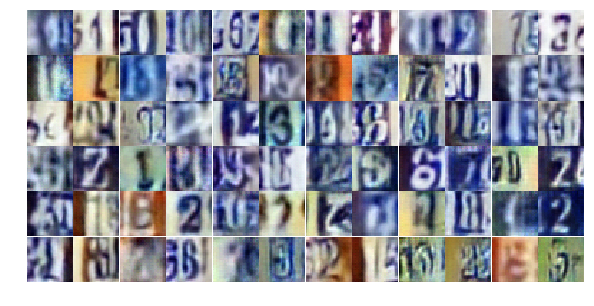

Epoch 11/25... Discriminator Loss: 0.7204... Generator Loss: 1.2530
Epoch 11/25... Discriminator Loss: 0.3850... Generator Loss: 1.9386
Epoch 11/25... Discriminator Loss: 0.5990... Generator Loss: 1.1869
Epoch 11/25... Discriminator Loss: 0.4262... Generator Loss: 1.3158
Epoch 11/25... Discriminator Loss: 1.4932... Generator Loss: 0.4041
Epoch 11/25... Discriminator Loss: 0.8348... Generator Loss: 0.8838
Epoch 11/25... Discriminator Loss: 1.1941... Generator Loss: 0.6241
Epoch 11/25... Discriminator Loss: 0.6478... Generator Loss: 1.2506
Epoch 11/25... Discriminator Loss: 0.9743... Generator Loss: 1.4717
Epoch 11/25... Discriminator Loss: 0.6760... Generator Loss: 1.0629


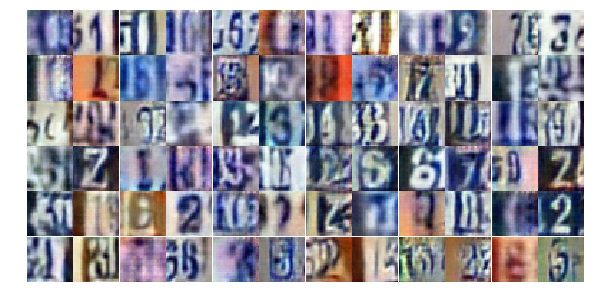

Epoch 12/25... Discriminator Loss: 1.3104... Generator Loss: 0.5254
Epoch 12/25... Discriminator Loss: 0.5233... Generator Loss: 1.4624
Epoch 12/25... Discriminator Loss: 0.7182... Generator Loss: 1.0832
Epoch 12/25... Discriminator Loss: 0.4368... Generator Loss: 1.8380
Epoch 12/25... Discriminator Loss: 0.6570... Generator Loss: 2.1531
Epoch 12/25... Discriminator Loss: 1.3553... Generator Loss: 0.4209
Epoch 12/25... Discriminator Loss: 0.5168... Generator Loss: 1.4556
Epoch 12/25... Discriminator Loss: 0.4051... Generator Loss: 1.7923
Epoch 12/25... Discriminator Loss: 0.5916... Generator Loss: 1.4489
Epoch 12/25... Discriminator Loss: 1.2942... Generator Loss: 0.5240


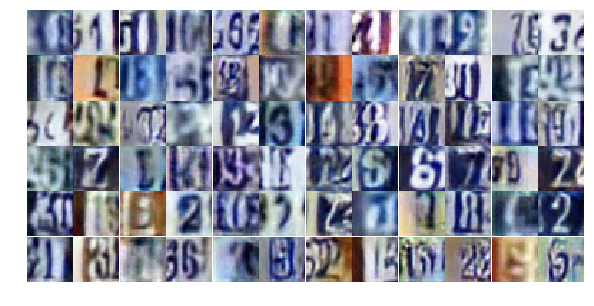

Epoch 12/25... Discriminator Loss: 0.4935... Generator Loss: 1.5461
Epoch 12/25... Discriminator Loss: 0.8735... Generator Loss: 0.7576
Epoch 12/25... Discriminator Loss: 0.5146... Generator Loss: 1.6870
Epoch 12/25... Discriminator Loss: 0.6273... Generator Loss: 1.6330
Epoch 12/25... Discriminator Loss: 0.5762... Generator Loss: 1.7137
Epoch 12/25... Discriminator Loss: 2.2520... Generator Loss: 0.4495
Epoch 12/25... Discriminator Loss: 1.6226... Generator Loss: 0.3060
Epoch 12/25... Discriminator Loss: 0.3876... Generator Loss: 1.6043
Epoch 12/25... Discriminator Loss: 0.6985... Generator Loss: 0.9440
Epoch 12/25... Discriminator Loss: 0.7914... Generator Loss: 0.8017


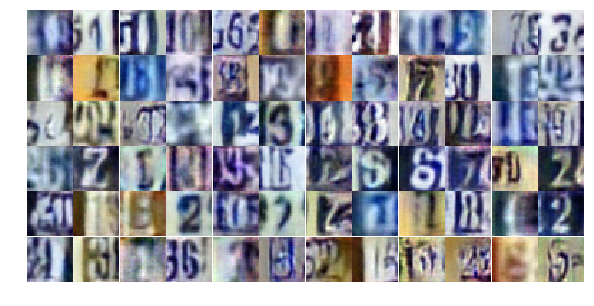

Epoch 12/25... Discriminator Loss: 0.3882... Generator Loss: 1.5245
Epoch 12/25... Discriminator Loss: 0.4084... Generator Loss: 2.4573
Epoch 12/25... Discriminator Loss: 0.4882... Generator Loss: 1.5488
Epoch 12/25... Discriminator Loss: 0.3663... Generator Loss: 1.7794
Epoch 12/25... Discriminator Loss: 0.3590... Generator Loss: 1.8721
Epoch 12/25... Discriminator Loss: 0.4942... Generator Loss: 1.2702
Epoch 12/25... Discriminator Loss: 0.4116... Generator Loss: 1.6430
Epoch 12/25... Discriminator Loss: 0.2493... Generator Loss: 2.1612
Epoch 12/25... Discriminator Loss: 0.6558... Generator Loss: 1.0983
Epoch 12/25... Discriminator Loss: 0.5591... Generator Loss: 1.8934


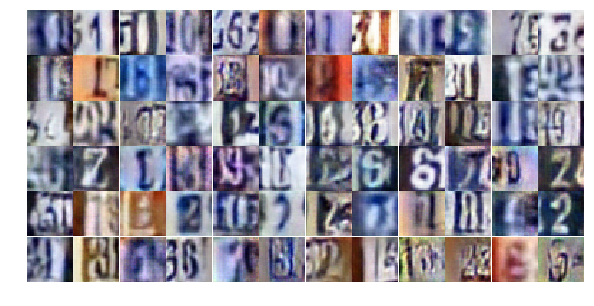

Epoch 12/25... Discriminator Loss: 0.6434... Generator Loss: 1.0835
Epoch 12/25... Discriminator Loss: 1.0234... Generator Loss: 0.6407
Epoch 12/25... Discriminator Loss: 0.9738... Generator Loss: 0.7265
Epoch 12/25... Discriminator Loss: 1.4439... Generator Loss: 0.3919
Epoch 12/25... Discriminator Loss: 1.3753... Generator Loss: 3.6981
Epoch 12/25... Discriminator Loss: 1.2351... Generator Loss: 0.5266
Epoch 12/25... Discriminator Loss: 0.9354... Generator Loss: 0.7061
Epoch 12/25... Discriminator Loss: 0.5515... Generator Loss: 1.4116
Epoch 12/25... Discriminator Loss: 0.4894... Generator Loss: 1.3531
Epoch 12/25... Discriminator Loss: 0.3470... Generator Loss: 1.6466


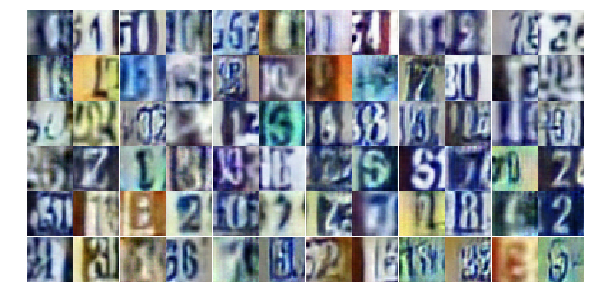

Epoch 12/25... Discriminator Loss: 0.4363... Generator Loss: 1.4181
Epoch 12/25... Discriminator Loss: 0.2886... Generator Loss: 1.8068
Epoch 12/25... Discriminator Loss: 0.3447... Generator Loss: 1.9384
Epoch 12/25... Discriminator Loss: 0.5394... Generator Loss: 1.2720
Epoch 12/25... Discriminator Loss: 0.7335... Generator Loss: 0.8985
Epoch 12/25... Discriminator Loss: 2.1131... Generator Loss: 0.2263
Epoch 12/25... Discriminator Loss: 0.7105... Generator Loss: 1.4568
Epoch 12/25... Discriminator Loss: 1.0201... Generator Loss: 0.6888
Epoch 12/25... Discriminator Loss: 0.5193... Generator Loss: 1.3946
Epoch 12/25... Discriminator Loss: 0.6437... Generator Loss: 1.0049


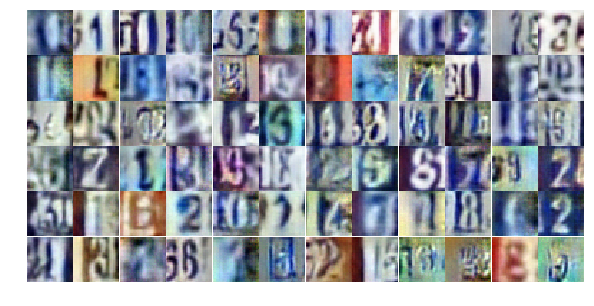

Epoch 12/25... Discriminator Loss: 0.6701... Generator Loss: 1.0672
Epoch 12/25... Discriminator Loss: 0.6723... Generator Loss: 1.0665
Epoch 12/25... Discriminator Loss: 0.9192... Generator Loss: 0.6759
Epoch 12/25... Discriminator Loss: 1.1441... Generator Loss: 0.5813
Epoch 12/25... Discriminator Loss: 0.4914... Generator Loss: 1.3537
Epoch 12/25... Discriminator Loss: 0.6029... Generator Loss: 1.5781
Epoch 12/25... Discriminator Loss: 1.1404... Generator Loss: 0.5462
Epoch 13/25... Discriminator Loss: 0.4420... Generator Loss: 1.4793
Epoch 13/25... Discriminator Loss: 0.3924... Generator Loss: 1.6138
Epoch 13/25... Discriminator Loss: 1.0657... Generator Loss: 0.5991


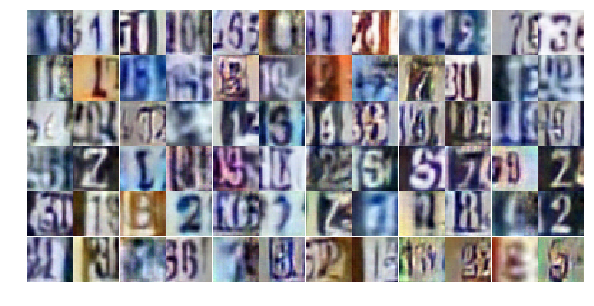

Epoch 13/25... Discriminator Loss: 0.5570... Generator Loss: 1.5675
Epoch 13/25... Discriminator Loss: 0.5637... Generator Loss: 1.7362
Epoch 13/25... Discriminator Loss: 0.8956... Generator Loss: 0.8164
Epoch 13/25... Discriminator Loss: 1.0431... Generator Loss: 0.6269
Epoch 13/25... Discriminator Loss: 0.5982... Generator Loss: 1.0956
Epoch 13/25... Discriminator Loss: 0.7234... Generator Loss: 0.9874
Epoch 13/25... Discriminator Loss: 0.2765... Generator Loss: 2.4107
Epoch 13/25... Discriminator Loss: 0.6197... Generator Loss: 1.0014
Epoch 13/25... Discriminator Loss: 0.6309... Generator Loss: 1.0115
Epoch 13/25... Discriminator Loss: 0.5344... Generator Loss: 1.5981


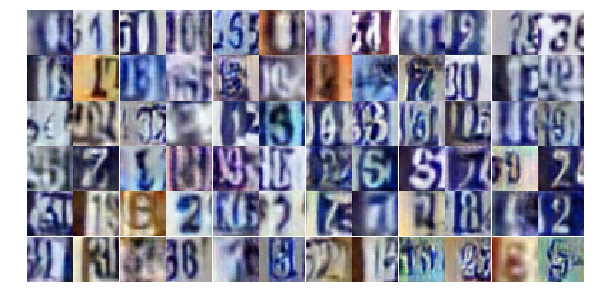

Epoch 13/25... Discriminator Loss: 0.4637... Generator Loss: 1.3887
Epoch 13/25... Discriminator Loss: 0.4281... Generator Loss: 1.5430
Epoch 13/25... Discriminator Loss: 2.9865... Generator Loss: 3.7093
Epoch 13/25... Discriminator Loss: 1.2951... Generator Loss: 0.5617
Epoch 13/25... Discriminator Loss: 0.4846... Generator Loss: 1.6852
Epoch 13/25... Discriminator Loss: 1.2513... Generator Loss: 0.4925
Epoch 13/25... Discriminator Loss: 0.6172... Generator Loss: 1.2541
Epoch 13/25... Discriminator Loss: 0.6515... Generator Loss: 1.1314
Epoch 13/25... Discriminator Loss: 0.7885... Generator Loss: 0.9007
Epoch 13/25... Discriminator Loss: 0.8380... Generator Loss: 0.7978


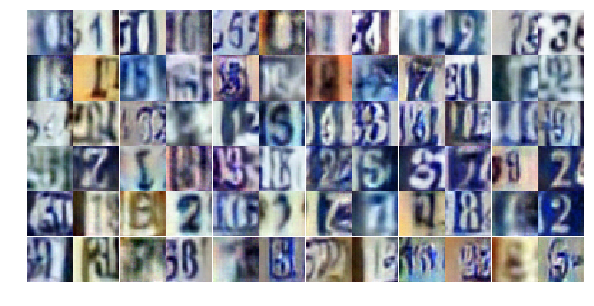

Epoch 13/25... Discriminator Loss: 0.7477... Generator Loss: 0.8636
Epoch 13/25... Discriminator Loss: 0.4429... Generator Loss: 1.5840
Epoch 13/25... Discriminator Loss: 0.5716... Generator Loss: 1.4932
Epoch 13/25... Discriminator Loss: 0.5178... Generator Loss: 1.3357
Epoch 13/25... Discriminator Loss: 0.8211... Generator Loss: 0.7441
Epoch 13/25... Discriminator Loss: 0.9990... Generator Loss: 0.7286
Epoch 13/25... Discriminator Loss: 1.2336... Generator Loss: 1.6289
Epoch 13/25... Discriminator Loss: 0.5378... Generator Loss: 1.4868
Epoch 13/25... Discriminator Loss: 0.5474... Generator Loss: 1.4332
Epoch 13/25... Discriminator Loss: 0.5706... Generator Loss: 1.3736


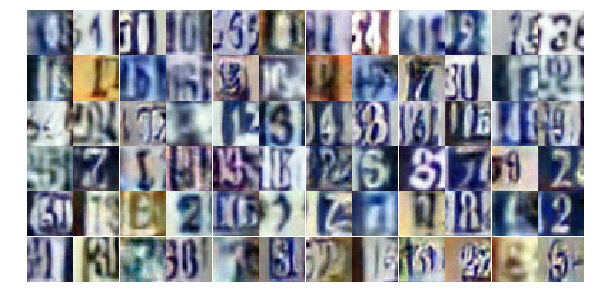

Epoch 13/25... Discriminator Loss: 0.8333... Generator Loss: 0.7882
Epoch 13/25... Discriminator Loss: 0.9844... Generator Loss: 0.7910


KeyboardInterrupt: 

In [36]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

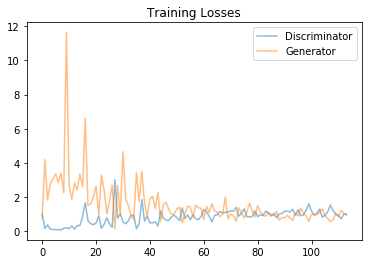

In [37]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

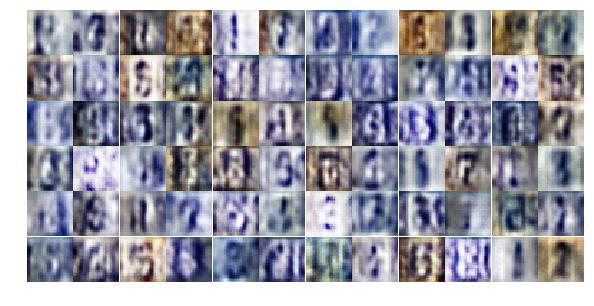

In [38]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))